In [19]:
import os
import pandas as pd
import numpy as np

# Define population types and censoring percentages
populations = ["t1d", "t2d", "iso"]
censoring_levels = ["0.95", "0.9", "0.8", "0.7"]

# Generate file paths dynamically
csv_files = {f"{pop}_{cens}": f"C:/PhD/codeAIHN/imputation_OOR/results/{pop}/gp_{pop}_matern32_{cens}.csv" for pop in populations for cens in censoring_levels}

# Initialize a dictionary to store extracted data
metrics = {cens: {"Mean": [], "SD": [], "CV": []} for cens in censoring_levels}
reductions = {cens: {"Mean": [], "SD": [], "CV": []} for cens in censoring_levels}

# Read CSV files and extract relevant values
for key, file in csv_files.items():
    if os.path.exists(file):
        df = pd.read_csv(file)
        censoring_level = key.split("_")[-1]
        for metric in metrics[censoring_level].keys():
            row = df[df['Metric'] == metric]
            if not row.empty:
                mse_before = row['MSE Before Imputation'].values[0]
                mse_after = row['MSE After Imputation'].values[0]
                bias_before = row['Bias Before Imputation'].values[0]
                bias_after = row['Bias After Imputation'].values[0]
                
                metrics[censoring_level][metric].append((mse_after, bias_after))
                reductions[censoring_level][metric].append(((mse_before - mse_after), (bias_before - bias_after)))

# Function to compute mean and standard deviation
def compute_avg_std(data):
    mse_values = [x[0] for x in data]
    bias_values = [x[1] for x in data]
    return {
        "MSE Mean": (np.mean(mse_values), np.std(mse_values)),
        "Bias Mean": (np.mean(bias_values), np.std(bias_values))
    }

# Compute results for each censoring level and metric
results = {cens: {metric: compute_avg_std(values) for metric, values in metrics[cens].items()} for cens in censoring_levels}
reductions_results = {cens: {metric: compute_avg_std(values) for metric, values in reductions[cens].items()} for cens in censoring_levels}

# Print results for each censoring level and metric
for cens, metrics_values in results.items():
    print(f"Results for {cens}% censoring:")
    for metric, values in metrics_values.items():
        print(f"  Average MSE of Matern32 across the three populations and {metric} BG = {values['MSE Mean'][0]:.4f} +/- {values['MSE Mean'][1]:.4f}")
        print(f"  Average Bias of Matern32 across the three populations and {metric} BG = {values['Bias Mean'][0]:.4f} +/- {values['Bias Mean'][1]:.4f}\n")

# Print reduction results for each censoring level and metric
for cens, metrics_values in reductions_results.items():
    print(f"Reduction in MSE and Bias after Imputation for {cens}% censoring:")
    for metric, values in metrics_values.items():
        print(f"  Average Reduction in MSE for {metric} BG = {values['MSE Mean'][0]:.4f} +/- {values['MSE Mean'][1]:.4f}")
        print(f"  Average Reduction in Bias for {metric} BG = {values['Bias Mean'][0]:.4f} +/- {values['Bias Mean'][1]:.4f}\n")


Results for 0.95% censoring:
  Average MSE of Matern32 across the three populations and Mean BG = 0.0004 +/- 0.0002
  Average Bias of Matern32 across the three populations and Mean BG = -0.0126 +/- 0.0043

  Average MSE of Matern32 across the three populations and SD BG = 0.0016 +/- 0.0008
  Average Bias of Matern32 across the three populations and SD BG = -0.0243 +/- 0.0068

  Average MSE of Matern32 across the three populations and CV BG = 0.0016 +/- 0.0004
  Average Bias of Matern32 across the three populations and CV BG = -0.2481 +/- 0.0483

Results for 0.9% censoring:
  Average MSE of Matern32 across the three populations and Mean BG = 0.0040 +/- 0.0018
  Average Bias of Matern32 across the three populations and Mean BG = -0.0314 +/- 0.0194

  Average MSE of Matern32 across the three populations and SD BG = 0.0141 +/- 0.0005
  Average Bias of Matern32 across the three populations and SD BG = -0.0451 +/- 0.0300

  Average MSE of Matern32 across the three populations and CV BG = 0.0

In [3]:
import pandas as pd
import glob
import os

# Function to read CSVs and create the two dataframes
def create_dataframes_from_csv(directory_path):
    # Population types and censoring percentages
    populations = ['t1d', 't2d', 'iso']
    censoring_values = ['0.95','0.9','0.8', '0.7']
    
    # Initialize empty lists to store data for both dataframes
    first_df_data = []
    second_df_data = []

    # Loop over each population and censoring value
    for population in populations:
        for censoring in censoring_values:
            # Construct the filename for each combination
            filename = f"C:/PhD/codeAIHN/imputation_OOR/results/{population}/imputationMetrics/gp_{population}_matern32_{censoring}_imputationMetrics.csv"
            file_path = os.path.join(directory_path, filename)
            
            # Check if the file exists
            if os.path.exists(file_path):
                # Read the current CSV file
                df = pd.read_csv(file_path)

                # Extract data for the first dataframe (Median, Q25, Q75)
                first_df_data.append({
                    'Population': population,
                    'Censoring': censoring,
                    'Metric': 'MSE',
                    'Model': 'GP',
                    'Median': df['MSE_GP_Median'][0],
                    'Q25': df['MSE_GP_Q25'][0],
                    'Q75': df['MSE_GP_Q75'][0]
                })
                first_df_data.append({
                    'Population': population,
                    'Censoring': censoring,
                    'Metric': 'R2',
                    'Model': 'GP',
                    'Median': df['R2_GP_Median'][0],
                    'Q25': df['R2_GP_Q25'][0],
                    'Q75': df['R2_GP_Q75'][0]
                })
                first_df_data.append({
                    'Population': population,
                    'Censoring': censoring,
                    'Metric': 'MSE',
                    'Model': 'BAS',
                    'Median': df['MSE_BAS_Median'][0],
                    'Q25': df['MSE_BAS_Q25'][0],
                    'Q75': df['MSE_BAS_Q75'][0]
                })
                first_df_data.append({
                    'Population': population,
                    'Censoring': censoring,
                    'Metric': 'R2',
                    'Model': 'BAS',
                    'Median': df['R2_BAS_Median'][0],
                    'Q25': df['R2_BAS_Q25'][0],
                    'Q75': df['R2_BAS_Q75'][0]
                })
                
                # Extract data for the second dataframe (Mean, SD)
                second_df_data.append({
                    'Population': population,
                    'Censoring': censoring,
                    'Metric': 'MSE',
                    'Model': 'GP',
                    'Mean': df['MSE_GP_Mean'][0],
                    'SD': df['MSE_GP_SD'][0]
                })
                second_df_data.append({
                    'Population': population,
                    'Censoring': censoring,
                    'Metric': 'R2',
                    'Model': 'GP',
                    'Mean': df['R2_GP_Mean'][0],
                    'SD': df['R2_GP_SD'][0]
                })
                second_df_data.append({
                    'Population': population,
                    'Censoring': censoring,
                    'Metric': 'MSE',
                    'Model': 'BAS',
                    'Mean': df['MSE_BAS_Mean'][0],
                    'SD': df['MSE_BAS_SD'][0]
                })
                second_df_data.append({
                    'Population': population,
                    'Censoring': censoring,
                    'Metric': 'R2',
                    'Model': 'BAS',
                    'Mean': df['R2_BAS_Mean'][0],
                    'SD': df['R2_BAS_SD'][0]
                })
            else:
                print(f"Warning: File {filename} does not exist!")

    # Create the dataframes
    first_df = pd.DataFrame(first_df_data)
    second_df = pd.DataFrame(second_df_data)

    return first_df, second_df

# Example usage: Assuming your CSV files are in a directory called "data"
directory_path = "path_to_your_csv_files"
first_df, second_df = create_dataframes_from_csv(directory_path)

# Display the dataframes
print("First DataFrame (Median, Q25, Q75):")
print(first_df)
print("\nSecond DataFrame (Mean, SD):")
print(second_df)


First DataFrame (Median, Q25, Q75):
   Population Censoring Metric Model    Median       Q25        Q75
0         t1d      0.95    MSE    GP  0.587323  0.344343   1.059309
1         t1d      0.95     R2    GP  0.868454  0.773988   0.923749
2         t1d      0.95    MSE   BAS  1.630777  1.081213   2.629747
3         t1d      0.95     R2   BAS  0.629973  0.371815   0.752830
4         t1d       0.9    MSE    GP  1.601044  0.902985   3.063546
5         t1d       0.9     R2    GP  0.632951  0.379352   0.797865
6         t1d       0.9    MSE   BAS  3.456171  2.267426   5.126550
7         t1d       0.9     R2   BAS  0.253829 -0.105619   0.471163
8         t1d       0.8    MSE    GP  4.838701  2.728864   8.255601
9         t1d       0.8     R2    GP  0.012064 -0.563578   0.371241
10        t1d       0.8    MSE   BAS  6.259946  4.349189   8.921107
11        t1d       0.8     R2   BAS -0.327169 -0.737103   0.021367
12        t1d       0.7    MSE    GP  8.841976  5.316145  13.961780
13        t1

Scatter Plot to show how much is the bias per patient based on the original mean BG value

In [29]:
# Get the parent directory path
parent_dir = os.path.abspath(os.path.join(os.getcwd(), ".."))
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)
    

from src.data_processing import (
    get_daily_segments_loc,
    check_and_filter_nan_segments,
)
from src.data_loaders import (
    load_data_iso,
    load_data_cap,
    load_data_cap1,
    load_data_ohio,
    load_data_glucobench,
)
from src.visualization import (
    visualize_original_interpolated,
)
from models.baselines import naive_baseline_imputation
from models.gp import train_gpr, inference_gpr
from src.bg_statistics import compare_statistics

def main(dataset = 'iso', method = 'gp', kernel = 'matern32', percentile = 0.8):
    # Step 1: Load data
    print("Loading data...")
    if dataset == "ohio":
        patient_ids = [
            "540",
            "544",
            "552",
            "559",
            "563",
            "567",
            "570",
            "575",
            "584",
            "588",
            "591",
            "596",
        ]
        train_data_dict = {}
        test_data_dict = {}
        all_data_dict = {}
        for patient_id in patient_ids:
            _, train_data, test_data, all_data = load_data_ohio(
                patient_id, include_test=True
            )
            train_data_dict[patient_id] = train_data
            test_data_dict[patient_id] = test_data
            all_data_dict[patient_id] = all_data
    elif dataset == "iso":
        patient_ids = [str(i) for i in range(102, 224)]
        to_remove = [
            "103",
            "108",
            "110",
            "113",
            "115",
            "116",  # Not sure yet
            "122",
            "126",
            "127",
            "128",
            "130",
            "134",
            "139",
            "143",
            "144",
            "146",
            "149",
            "152",
            "155",
            "156",
            "164",
            "174",
            "175",
            "176",
            "177",
            "180",
            "185",
            "186",
            "190",
            "193",
            "194",
            "197",
            "203",
            "206",
            "211",
            "212",
            "220",
        ]
        patient_ids = list(set(patient_ids) - set(to_remove))
        all_data_dict = {}

        for patient_id in patient_ids:
            all_data = load_data_iso(patient_id)
            all_data_dict[patient_id] = all_data

    elif (
        dataset == "iglu"
        or dataset == "dubosson"
        or dataset == "weinstock"
        or dataset == "colas"
        or dataset == "hall"
        or dataset == "T1DEXI_adults"
    ):
        all_data_dict, patient_ids = load_data_glucobench(dataset)
    elif dataset == "t1d":
        patient_id_ohio = [
            "540",
            "544",
            "552",
            "559",
            "563",
            "567",
            "570",
            "575",
            "584",
            "588",
            "591",
            "596",
        ]
        train_data_dict = {}
        test_data_dict = {}
        all_data_dict = {}
        # Update patient ids to be unique for Ohio dataset
        for patient_id in patient_id_ohio:
            unique_patient_id = f"ohio_{patient_id}"  # Add a prefix to make it unique
            _, train_data, test_data, all_data = load_data_ohio(
                patient_id, include_test=True
            )

            train_data_dict[unique_patient_id] = train_data
            test_data_dict[unique_patient_id] = test_data
            all_data_dict[unique_patient_id] = all_data

        # Update patient ids to be unique for Dubosson dataset
        all_data_dubosson, patient_id_dubosson = load_data_glucobench("dubosson")
        for patient_id in patient_id_dubosson:
            unique_patient_id = f"dubosson_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_dubosson[patient_id]

        # Update patient ids to be unique for Weinstock dataset
        all_data_weinstock, patient_id_weinstock = load_data_glucobench("weinstock")
        for patient_id in patient_id_weinstock:
            unique_patient_id = f"weinstock_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_weinstock[patient_id]

        # Update patient ids to be unique for T1DEXI_adults dataset
        all_data_t1dexi, patient_id_t1dexi = load_data_glucobench("T1DEXI_adults")
        for patient_id in patient_id_t1dexi:
            unique_patient_id = (
                f"T1DEXI_adults_{patient_id}"  # Add a prefix for uniqueness
            )
            all_data_dict[unique_patient_id] = all_data_t1dexi[patient_id]

        # Create a list of all unique patient IDs from all datasets
        patient_ids = (
            [f"ohio_{id}" for id in patient_id_ohio]
            + [f"weinstock_{id}" for id in patient_id_weinstock]
            + [f"dubosson_{id}" for id in patient_id_dubosson]
            + [f"T1DEXI_adults_{id}" for id in patient_id_t1dexi]
        )
    elif dataset == "t2d":
        all_data_dict = {}
        all_data_colas, patient_id_colas = load_data_glucobench("colas")
        print(patient_id_colas)
        for patient_id in patient_id_colas:
            unique_patient_id = f"colas_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_colas[patient_id]

        all_data_iglu, patient_id_iglu = load_data_glucobench("iglu")
        print(patient_id_iglu)
        for patient_id in patient_id_iglu:
            unique_patient_id = f"iglu_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_iglu[patient_id]

        all_data_hall, patient_id_hall = load_data_glucobench("hall")
        print(patient_id_hall)
        for patient_id in patient_id_hall:
            unique_patient_id = f"hall_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_hall[patient_id]

        # Create a list of all unique patient IDs from all datasets
        patient_ids = (
            [f"colas_{id}" for id in patient_id_colas]
            + [f"iglu_{id}" for id in patient_id_iglu]
            + [f"hall_{id}" for id in patient_id_hall]
        )

    # print("patient ids = ", patient_ids)
    # print("all data = ", all_data_dict)

    print("all data = ", len(all_data_dict))
    # 1. create continues
    cont_segments_dict = {}
    filtered_segments_dict = {}

    for patient_id in patient_ids:
        patient_data = all_data_dict
        cont_segments_loc = get_daily_segments_loc(
            {patient_id: patient_data[patient_id]}, "cbg"
        )
        cont_segments_dict[patient_id] = cont_segments_loc[patient_id]
        filtered_segments = check_and_filter_nan_segments(
            patient_data[patient_id], cont_segments_dict[patient_id], "cbg"
        )
        filtered_segments_dict[patient_id] = filtered_segments

    # Initialize a new dictionary to store the segmented data per patient
    segmented_data_dict = {}
    segment_stats_dict = {}
    # Loop over each patient and extract their segments based on the filtered indices
    for patient_id, filtered_segments in filtered_segments_dict.items():
        # Get the start indices for the patient's filtered segments
        start_indices = filtered_segments["start_indices"]
        end_indices = filtered_segments["end_indices"]

        # Extract the corresponding data for each segment
        patient_data = all_data_dict[
            patient_id
        ]  # Assuming this is the full data for the patient

        # Initialize a list to store the segmented data for the patient
        patient_segments = []
        patient_segment_stats = []

        # Loop over the start indices to slice the data for each segment
        for i in range(
            len(start_indices)
        ):  # Loop until the second-to-last index (since we're using pairs)
            start_idx = start_indices[i]
            end_idx = end_indices[i]

            # Extract the segment for this pair of indices
            segment_data = patient_data[start_idx : end_idx + 1]["cbg"]

            # Calculate the length of the segment
            segment_length = len(segment_data)

            # Count the number of NaN values in the segment
            num_nan_values = np.sum(np.isnan(segment_data))

            if segment_length == 288:
                # print(f"The segment has {num_nan_values} NaN values.")
                # Append the segment to the patient's list of segments
                patient_segments.append(np.array(segment_data))

                # Store the statistics (length and NaN count) for this segment
                patient_segment_stats.append(
                    {"segment_length": segment_length, "num_nan_values": num_nan_values}
                )
        if len(patient_segments) != 0:
            # Store the segmented data in the dictionary, using the patient_id as the key
            segmented_data_dict[patient_id] = patient_segments
            segment_stats_dict[patient_id] = patient_segment_stats

    original_segments = segmented_data_dict

    # 2. censored segments
    # Dictionary for storing the interpolated data for each patient
    censored_segments = {}
    censored_thresh = {}
    censored_segment_indices = {}
    thresh_data = {}

    # Assuming 'original_data' is a dictionary with patient data, and each entry is a 1D array of continuous data points
    for patient_id, segments in original_segments.items():
        # Store interpolated segments for the current patient
        censored_segments[patient_id] = []
        censored_thresh[patient_id] = []
        censored_segment_indices[patient_id] = []
        thresh_data[patient_id] = []

        for segment in segments:
            if len(segment) != 288:
                print("segment len = ", len(segment))
            thresh = np.quantile(segment[~np.isnan(segment)], percentile)
            if thresh == np.max(segment[~np.isnan(segment)]):
                print("maximum thresh")
                filtered_segment = segment[~np.isnan(segment)]  # Remove NaN values
                filtered_segment = filtered_segment[
                    filtered_segment < np.max(filtered_segment)
                ]  # Exclude the max value
                # Compute the quantile on the filtered dataset
                thresh = np.quantile(filtered_segment, percentile)
                print("new thresh = ", thresh)
            # pint("thresh = ", thresh)
            censored_thresh[patient_id].append(thresh)
            censored_segment = np.where(segment > thresh, np.nan, segment)
            censored_segment_index = np.where(segment > thresh)

            censored_segments[patient_id].append(censored_segment)
            censored_segment_indices[patient_id].append(censored_segment_index)
            thresh_data[patient_id].append(thresh)

    # print("All censored segments:", censored_segments)

    # Now the cleaned_sensored_segments and cleaned_original_segments dictionaries
    # contain segments without leading or trailing NaN values, and they are aligned.
    # print("Cleaned Sensored Segments:", cleaned_sensored_segments)
    # print("Cleaned Original Segments:", cleaned_original_segments)
    if method == "polynomial":
        interpolated_segments_poly = naive_baseline_imputation(
            data=censored_segments, method="polynomial", order=2
        )
    elif method == "cubic":
        interpolated_segments_cubic = naive_baseline_imputation(
            data=censored_segments, method="cubic"
        )
    elif method == "ffill":
        interpolated_segments_ffill = naive_baseline_imputation(
            data=censored_segments, method="ffill"
        )
    elif method == "gp":
        scatter_plot = {}
        interpolated_segments_gp = {}
        for patient_id, segments in censored_segments.items():
            interpolated_segments_gp[patient_id] = []
            for i in range(len(segments)):
                # Convert segment to DataFrame to use interpolation functions
                segment_df = pd.DataFrame(segments[i], columns=["cbg"])
                # Check if there are any NaN values in the segment
                if segment_df["cbg"].isna().any():
                    ind_all = np.where(~np.isnan(np.array(segment_df)))[0]
                    var = np.std(np.array(segment_df)[ind_all]) ** 2
                    # Only train and infer if there are NaN values
                    gpr = train_gpr(np.array(segment_df), var=var, kernel=kernel)
                    indices, interpolated_segment, std = inference_gpr(
                        censored_segment_indices[patient_id][i][0], gpr
                    )

                    # Create a copy of the original segment and replace NaNs with interpolated values
                    indices = indices.flatten()  # Ensure `indices` is a flat array
                    full_interpolated_segment = np.array(segment_df).flatten().copy()

                    full_interpolated_segment[indices] = np.array(
                        interpolated_segment
                    ).flatten()  # Replace NaNs with interpolated values
                    interpolated_segments_gp[patient_id].append(
                        full_interpolated_segment
                    )

                    # plt.figure()
                    # plt.plot(full_interpolated_segment)
                    # plt.plot(np.array(segment_df).flatten().copy())

                else:
                    # If no NaN values, add the original segment without modification
                    interpolated_segments_gp[patient_id].append(
                        np.array(segment_df).flatten()
                    )
            bias_after = (
            np.nanmean(np.concatenate(interpolated_segments_gp[patient_id])) - np.nanmean(np.concatenate(original_segments[patient_id]))
            )
            
            scatter_plot[patient_id] = [bias_after, np.nanmean(np.concatenate(original_segments[patient_id]))]
        
    return scatter_plot


In [30]:
scatter_plot_inpatients = main()

Loading data...
all data =  85


In [31]:
scatter_plot_T1Doutpatients = main(dataset='t1d')

Loading data...
all data =  717


 C:\Users\Maria Panagiotou\AppData\Roaming\Python\Python311\site-packages\GPy\kern\src\stationary.py:168: RuntimeWarning:overflow encountered in divide
 C:\Users\Maria Panagiotou\AppData\Roaming\Python\Python311\site-packages\GPy\kern\src\stationary.py:489: RuntimeWarning:overflow encountered in multiply
 C:\Users\Maria Panagiotou\AppData\Roaming\Python\Python311\site-packages\GPy\kern\src\stationary.py:489: RuntimeWarning:invalid value encountered in multiply


In [33]:
scatter_plot_T2Doutpatients = main(dataset='t2d')

Loading data...
dict_keys(['121', '153', '155', '157', '161', '172', '185', '191', '195', '22', '23', '25', '28', '31', '56', '86', '93'])
dict_keys(['Subject 1', 'Subject 2', 'Subject 3', 'Subject 4', 'Subject 5'])
dict_keys(['1636-69-001', '1636-69-091', '2133-004', '2133-018', '2133-039'])
all data =  27


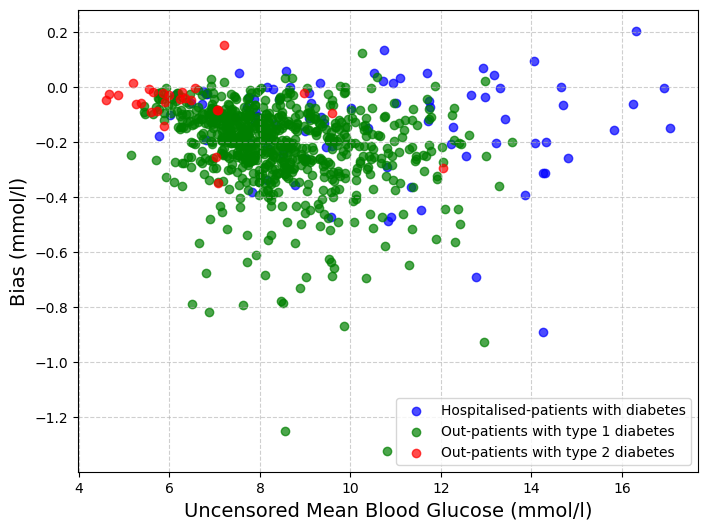

In [34]:
# Function to extract bias and mean blood glucose values
def extract_data(data):
    bias = [values[0] for values in data.values()]
    mean_blood_glucose = [values[1] for values in data.values()]
    return mean_blood_glucose, bias

# Extract data from each dataset
mean1, bias1 = extract_data(scatter_plot_inpatients)
mean2, bias2 = extract_data(scatter_plot_T1Doutpatients)
mean3, bias3 = extract_data(scatter_plot_T2Doutpatients)

# Create the scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(mean1, bias1, color='blue', alpha=0.7, label='Hospitalised-patients with diabetes')
plt.scatter(mean2, bias2, color='green', alpha=0.7, label='Out-patients with type 1 diabetes')
plt.scatter(mean3, bias3, color='red', alpha=0.7, label='Out-patients with type 2 diabetes')

# Add labels, title, and legend
plt.xlabel("Uncensored Mean Blood Glucose (mmol/l)", fontsize=14)
plt.ylabel("Bias (mmol/l)", fontsize=14)
plt.legend()

# Add grid and show plot
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

In [35]:
scatter_plot_inpatients = main(percentile=0.7)

Loading data...
all data =  85


In [36]:
scatter_plot_T1Doutpatients = main(dataset='t1d', percentile=0.7)

Loading data...
all data =  717


 C:\Users\Maria Panagiotou\AppData\Roaming\Python\Python311\site-packages\GPy\kern\src\stationary.py:168: RuntimeWarning:overflow encountered in divide
 C:\Users\Maria Panagiotou\AppData\Roaming\Python\Python311\site-packages\GPy\kern\src\stationary.py:489: RuntimeWarning:overflow encountered in multiply
 C:\Users\Maria Panagiotou\AppData\Roaming\Python\Python311\site-packages\GPy\kern\src\stationary.py:489: RuntimeWarning:invalid value encountered in multiply


In [37]:
scatter_plot_T2Doutpatients = main(dataset='t2d', percentile=0.7)

Loading data...
dict_keys(['121', '153', '155', '157', '161', '172', '185', '191', '195', '22', '23', '25', '28', '31', '56', '86', '93'])
dict_keys(['Subject 1', 'Subject 2', 'Subject 3', 'Subject 4', 'Subject 5'])
dict_keys(['1636-69-001', '1636-69-091', '2133-004', '2133-018', '2133-039'])
all data =  27


In [38]:
# Function to extract bias and mean blood glucose values
def extract_data(data):
    bias = [values[0] for values in data.values()]
    mean_blood_glucose = [values[1] for values in data.values()]
    return mean_blood_glucose, bias

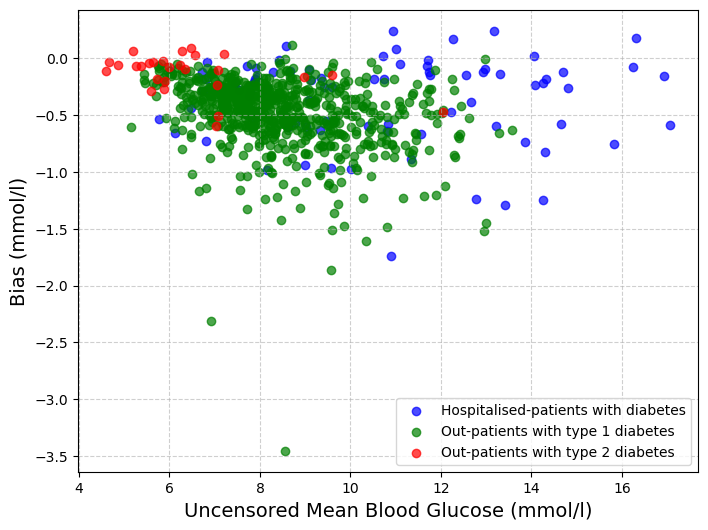

In [39]:
# Extract data from each dataset
mean1, bias1 = extract_data(scatter_plot_inpatients)
mean2, bias2 = extract_data(scatter_plot_T1Doutpatients)
mean3, bias3 = extract_data(scatter_plot_T2Doutpatients)

# Create the scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(mean1, bias1, color='blue', alpha=0.7, label='Hospitalised-patients with diabetes')
plt.scatter(mean2, bias2, color='green', alpha=0.7, label='Out-patients with type 1 diabetes')
plt.scatter(mean3, bias3, color='red', alpha=0.7, label='Out-patients with type 2 diabetes')

# Add labels, title, and legend
plt.xlabel("Uncensored Mean Blood Glucose (mmol/l)", fontsize=14)
plt.ylabel("Bias (mmol/l)", fontsize=14)
plt.legend()

# Add grid and show plot
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

It could be interesting to make a graph with the "The average (SD) reduction in MSE between the datasets with censoring and after imputation" og the Y-axis and censoring-% on the X-axis. This graph could tell us at which censoring-% imputation is important. 

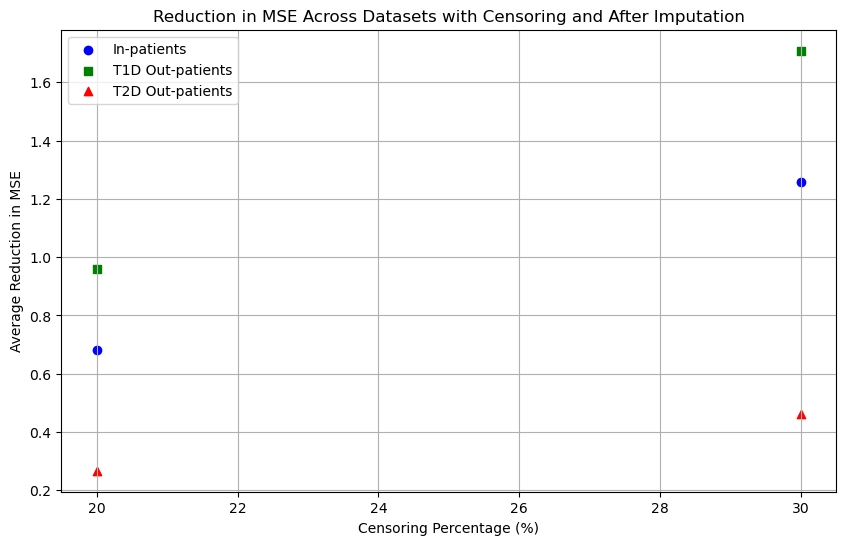

In [5]:
# Data for 20% and 30% censoring for the three datasets
censoring_percentages = [20, 30]

# MSE reductions for In-patients, T1D out-patients, and T2D out-patients
mse_in_patients = [
    np.mean(np.array([0.724696]) - np.array([0.043585])),
    np.mean(np.array([1.486056]) - np.array([0.229472]))
]
mse_t1d_out_patients = [
    np.mean(np.array([1.030228]) - np.array([0.072033])),
    np.mean(np.array([2.035082]) - np.array([0.326547]))
]
mse_t2d_out_patients = [
    np.mean(np.array([0.281256]) - np.array([0.013998])),
    np.mean(np.array([0.508739]) - np.array([0.045855]))
]

# Scatter plot
plt.figure(figsize=(10, 6))

# Plotting each dataset
plt.scatter(censoring_percentages, mse_in_patients, label='In-patients', marker='o', color='blue')
plt.scatter(censoring_percentages, mse_t1d_out_patients, label='T1D Out-patients', marker='s', color='green')
plt.scatter(censoring_percentages, mse_t2d_out_patients, label='T2D Out-patients', marker='^', color='red')

# Adding labels, legend, and title
plt.xlabel('Censoring Percentage (%)')
plt.ylabel('Average Reduction in MSE')
plt.title('Reduction in MSE Across Datasets with Censoring and After Imputation')
plt.legend()
plt.grid(True)

# Display the plot
plt.show()


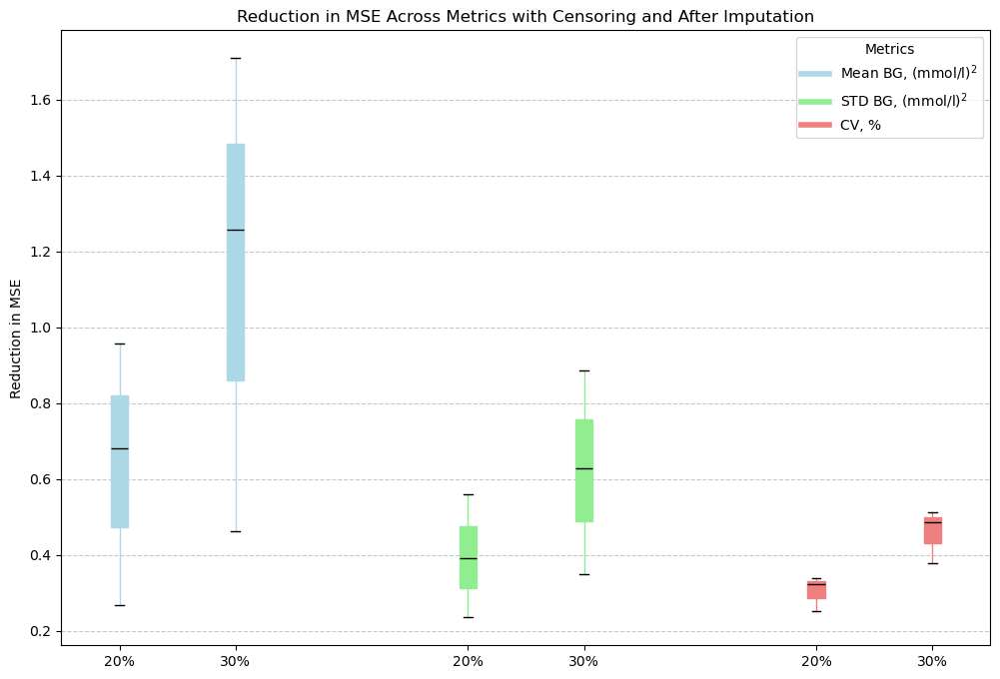

In [19]:
# Data for box plots categorized by metrics (Mean BG, STD BG, CV)
mse_reduction_metrics = {
    r"Mean BG, $(\mathrm{mmol}/\mathrm{l})^2$": [
        [0.724696 - 0.043585, 1.030228 - 0.072033, 0.281256 - 0.013998],  # 20% censoring
        [1.486056 - 0.229472, 2.035082 - 0.326547, 0.508739 - 0.045855]   # 30% censoring
    ],
    r"STD BG, $(\mathrm{mmol}/\mathrm{l})^2$": [
        [0.463321 - 0.071022, 0.653051 - 0.091774, 0.271864 - 0.036058],  # 20% censoring
        [0.790827 - 0.162213, 1.098998 - 0.213991, 0.412339 - 0.062474]   # 30% censoring
    ],
    "CV, %": [
        [(0.003017 - 0.000505)*100, (0.003919 - 0.000695)*100, (0.003946 - 0.000564)*100],  # 20% censoring
        [(0.004951 - 0.001170)*100, (0.006386 - 0.001261)*100, (0.005872 - 0.001012)*100]   # 30% censoring
    ]
}

# Creating a grouped box plot for the three metrics
plt.figure(figsize=(12, 8))

positions = [1, 2, 4, 5, 7, 8]  # Positions for box plots
colors = ['lightblue', 'lightgreen', 'lightcoral']  # Colors for each metric
metric_names = list(mse_reduction_metrics.keys())

# Plot each metric
for i, (metric, data) in enumerate(mse_reduction_metrics.items()):
    plt.boxplot(data, positions=[positions[i * 2], positions[i * 2 + 1]], patch_artist=True, notch=False,
                boxprops=dict(facecolor=colors[i], color=colors[i]), 
                medianprops=dict(color='black'), whiskerprops=dict(color=colors[i]), 
                labels=['20%', '30%'])

# Adding labels and title
plt.xticks(ha='center')
plt.ylabel('Reduction in MSE')
plt.title('Reduction in MSE Across Metrics with Censoring and After Imputation')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Adding legend
custom_legend = [plt.Line2D([0], [0], color=color, lw=4) for color in colors]
plt.legend(custom_legend, metric_names, loc='upper right', title='Metrics')

# Display the plot
plt.show()


Ablation Study

In [40]:
def calculate_meanBG(dataset = 'iso', method = 'gp', kernel = 'matern32', percentile = 0.8):
    if dataset == "ohio":
        patient_ids = [
            "540",
            "544",
            "552",
            "559",
            "563",
            "567",
            "570",
            "575",
            "584",
            "588",
            "591",
            "596",
        ]
        train_data_dict = {}
        test_data_dict = {}
        all_data_dict = {}
        for patient_id in patient_ids:
            _, train_data, test_data, all_data = load_data_ohio(
                patient_id, include_test=True
            )
            train_data_dict[patient_id] = train_data
            test_data_dict[patient_id] = test_data
            all_data_dict[patient_id] = all_data
    elif dataset == "iso":
        patient_ids = [str(i) for i in range(102, 224)]
        to_remove = [
            "103",
            "108",
            "110",
            "113",
            "115",
            "116",  # Not sure yet
            "122",
            "126",
            "127",
            "128",
            "130",
            "134",
            "139",
            "143",
            "144",
            "146",
            "149",
            "152",
            "155",
            "156",
            "164",
            "174",
            "175",
            "176",
            "177",
            "180",
            "185",
            "186",
            "190",
            "193",
            "194",
            "197",
            "203",
            "206",
            "211",
            "212",
            "220",
        ]
        patient_ids = list(set(patient_ids) - set(to_remove))
        all_data_dict = {}

        for patient_id in patient_ids:
            all_data = load_data_iso(patient_id)
            all_data_dict[patient_id] = all_data


    elif (
        dataset == "iglu"
        or dataset == "dubosson"
        or dataset == "weinstock"
        or dataset == "colas"
        or dataset == "hall"
        or dataset == "T1DEXI_adults"
    ):
        all_data_dict, patient_ids = load_data_glucobench(dataset)
    elif dataset == "t1d":
        patient_id_ohio = [
            "540",
            "544",
            "552",
            "559",
            "563",
            "567",
            "570",
            "575",
            "584",
            "588",
            "591",
            "596",
        ]
        train_data_dict = {}
        test_data_dict = {}
        all_data_dict = {}
        # Update patient ids to be unique for Ohio dataset
        for patient_id in patient_id_ohio:
            unique_patient_id = f"ohio_{patient_id}"  # Add a prefix to make it unique
            _, train_data, test_data, all_data = load_data_ohio(
                patient_id, include_test=True
            )

            train_data_dict[unique_patient_id] = train_data
            test_data_dict[unique_patient_id] = test_data
            all_data_dict[unique_patient_id] = all_data

        # Update patient ids to be unique for Dubosson dataset
        all_data_dubosson, patient_id_dubosson = load_data_glucobench("dubosson")
        for patient_id in patient_id_dubosson:
            unique_patient_id = f"dubosson_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_dubosson[patient_id]

        # Update patient ids to be unique for Weinstock dataset
        all_data_weinstock, patient_id_weinstock = load_data_glucobench("weinstock")
        for patient_id in patient_id_weinstock:
            unique_patient_id = f"weinstock_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_weinstock[patient_id]

        # Update patient ids to be unique for T1DEXI_adults dataset
        all_data_t1dexi, patient_id_t1dexi = load_data_glucobench("T1DEXI_adults")
        for patient_id in patient_id_t1dexi:
            unique_patient_id = (
                f"T1DEXI_adults_{patient_id}"  # Add a prefix for uniqueness
            )
            all_data_dict[unique_patient_id] = all_data_t1dexi[patient_id]

        # Create a list of all unique patient IDs from all datasets
        patient_ids = (
            [f"ohio_{id}" for id in patient_id_ohio]
            + [f"weinstock_{id}" for id in patient_id_weinstock]
            + [f"dubosson_{id}" for id in patient_id_dubosson]
            + [f"T1DEXI_adults_{id}" for id in patient_id_t1dexi]
        )
    elif dataset == "t2d":
        all_data_dict = {}
        all_data_colas, patient_id_colas = load_data_glucobench("colas")
        print(patient_id_colas)
        for patient_id in patient_id_colas:
            unique_patient_id = f"colas_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_colas[patient_id]

        all_data_iglu, patient_id_iglu = load_data_glucobench("iglu")
        print(patient_id_iglu)
        for patient_id in patient_id_iglu:
            unique_patient_id = f"iglu_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_iglu[patient_id]

        all_data_hall, patient_id_hall = load_data_glucobench("hall")
        print(patient_id_hall)
        for patient_id in patient_id_hall:
            unique_patient_id = f"hall_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_hall[patient_id]

        # Create a list of all unique patient IDs from all datasets
        patient_ids = (
            [f"colas_{id}" for id in patient_id_colas]
            + [f"iglu_{id}" for id in patient_id_iglu]
            + [f"hall_{id}" for id in patient_id_hall]
        )

    # 1. create continues
    cont_segments_dict = {}
    filtered_segments_dict = {}

    for patient_id in patient_ids:
        patient_data = all_data_dict
        cont_segments_loc = get_daily_segments_loc(
            {patient_id: patient_data[patient_id]}, "cbg"
        )
        cont_segments_dict[patient_id] = cont_segments_loc[patient_id]
        filtered_segments = check_and_filter_nan_segments(
            patient_data[patient_id], cont_segments_dict[patient_id], "cbg"
        )
        filtered_segments_dict[patient_id] = filtered_segments

    # Initialize a new dictionary to store the segmented data per patient
    segmented_data_dict = {}
    segment_stats_dict = {}
    # Loop over each patient and extract their segments based on the filtered indices
    for patient_id, filtered_segments in filtered_segments_dict.items():
        # Get the start indices for the patient's filtered segments
        start_indices = filtered_segments["start_indices"]
        end_indices = filtered_segments["end_indices"]

        # Extract the corresponding data for each segment
        patient_data = all_data_dict[
            patient_id
        ]  # Assuming this is the full data for the patient

        # Initialize a list to store the segmented data for the patient
        patient_segments = []
        patient_segment_stats = []

        # Loop over the start indices to slice the data for each segment
        for i in range(
            len(start_indices)
        ):  # Loop until the second-to-last index (since we're using pairs)
            start_idx = start_indices[i]
            end_idx = end_indices[i]

            # Extract the segment for this pair of indices
            segment_data = patient_data[start_idx : end_idx + 1]["cbg"]

            # Calculate the length of the segment
            segment_length = len(segment_data)

            # Count the number of NaN values in the segment
            num_nan_values = np.sum(np.isnan(segment_data))

            if segment_length == 288:
                # print(f"The segment has {num_nan_values} NaN values.")
                # Append the segment to the patient's list of segments
                patient_segments.append(np.array(segment_data))

                # Store the statistics (length and NaN count) for this segment
                patient_segment_stats.append(
                    {"segment_length": segment_length, "num_nan_values": num_nan_values}
                )
        if len(patient_segments) != 0:
            # Store the segmented data in the dictionary, using the patient_id as the key
            segmented_data_dict[patient_id] = patient_segments
            segment_stats_dict[patient_id] = patient_segment_stats

    original_segments = segmented_data_dict

    # 2. censored segments
    # Dictionary for storing the interpolated data for each patient
    censored_segments = {}
    censored_thresh = {}
    censored_segment_indices = {}
    thresh_data = {}

    # Assuming 'original_data' is a dictionary with patient data, and each entry is a 1D array of continuous data points
    for patient_id, segments in original_segments.items():
        # Store interpolated segments for the current patient
        censored_segments[patient_id] = []
        censored_thresh[patient_id] = []
        censored_segment_indices[patient_id] = []
        thresh_data[patient_id] = []

        for segment in segments:
            if len(segment) != 288:
                print("segment len = ", len(segment))
            thresh = np.quantile(segment[~np.isnan(segment)], percentile)
            # pint("thresh = ", thresh)
            censored_thresh[patient_id].append(thresh)
            censored_segment = np.where(segment > thresh, np.nan, segment)
            censored_segment_index = np.where(segment > thresh)

            censored_segments[patient_id].append(censored_segment)
            censored_segment_indices[patient_id].append(censored_segment_index)
            thresh_data[patient_id].append(thresh)


    bias_after_BG = []
    bias_after_STD = []
    meanBG_censored = []
    meanBG_original = []
    meanSTD_censored = []
    meanSTD_original = []
    for patient_id, segments in original_segments.items():
        meanBG_censored.append(np.nanmean(np.concatenate(censored_segments[patient_id])))
        meanBG_original.append(np.nanmean(np.concatenate(original_segments[patient_id])))
        meanSTD_censored.append(np.nanstd(np.concatenate(censored_segments[patient_id])))
        meanSTD_original.append(np.nanstd(np.concatenate(original_segments[patient_id])))
        bias_after_BG.append(
        np.nanmean(np.concatenate(censored_segments[patient_id])) - np.nanmean(np.concatenate(original_segments[patient_id]))
        )
        bias_after_STD.append(
        np.nanstd(np.concatenate(censored_segments[patient_id])) - np.nanstd(np.concatenate(original_segments[patient_id]))
        )
            
            # scatter_plot[patient_id] = [bias_after, np.nanmean(np.concatenate(original_segments[patient_id]))]
        
    return bias_after_BG, bias_after_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original

Paired t-Test

If the two lists represent paired measurements (e.g., pre-treatment vs. post-treatment for the same subjects), use a paired t-test:

In [41]:
from scipy.stats import ttest_rel
from scipy.stats import ttest_ind
from scipy.stats import shapiro
from scipy.stats import wilcoxon

biases1_BG = []
biases1_STD = []
mean1_BG_censored = []
mean1_BG_original = []
for i in np.arange(0.1, 1, 0.1):
    print("PERCENTILE = ", i)
    bias1_BG, bias1_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original = calculate_meanBG(percentile=i)
    
    biases1_BG.append(np.mean(bias1_BG))
    biases1_STD.append(np.mean(bias1_STD))
    mean1_BG_censored.append(meanBG_censored)
    mean1_BG_original.append(meanBG_original)

    differences = [o - c for o, c in zip(meanBG_censored, meanBG_original)]
    stat, p = shapiro(differences)
    if p < 0.05:
        print("Differences are not normally distributed.")
        # Perform Wilcoxon signed-rank test
        stat, p_value = wilcoxon(meanBG_original, meanBG_censored)

        # Interpret the result
        if p_value < 0.05:
            print("The difference between original and censored data is statistically significant.")
        else:
            print("The difference between original and censored data is not statistically significant.")
    else:
        print("Differences are normally distributed.")
        t_stat, p_value = ttest_rel(meanBG_original, meanBG_censored)
        # Check significance
        if p_value < 0.05:
            print("The difference between original and censored data is statistically significant.")
        else:
            print("The difference between original and censored data is not statistically significant.")
    
print("PERCENTILE = 0.99")
bias1_BG, bias1_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original = calculate_meanBG(percentile=0.99)
biases1_BG.append(np.mean(bias1_BG))
biases1_STD.append(np.mean(bias1_STD))
mean1_BG_censored.append(meanBG_censored)
mean1_BG_original.append(meanBG_original)
print(meanBG_censored)
print(meanBG_original)
differences = [o - c for o, c in zip(meanBG_censored, meanBG_original)]
stat, p = shapiro(differences)
if p < 0.05:
    print("Differences are not normally distributed.")
    # Perform Wilcoxon signed-rank test
    stat, p_value = wilcoxon(meanBG_original, meanBG_censored)

    # Interpret the result
    if p_value < 0.05:
        print("The difference between original and censored data is statistically significant.")
    else:
        print("The difference between original and censored data is not statistically significant.")
else:
    print("Differences are normally distributed.")
    t_stat, p_value = ttest_rel(meanBG_original, meanBG_censored)
    # Check significance
    if p_value < 0.05:
        print("The difference between original and censored data is statistically significant.")
    else:
        print("The difference between original and censored data is not statistically significant.")



PERCENTILE =  0.1
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.2
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.30000000000000004
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.4
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.5
Differences are normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.6
Differences are normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.7000000000000001
Differences are normally distributed.
The difference between original and censored data is statistically significant.
P

In [42]:
from scipy.stats import ttest_rel
from scipy.stats import ttest_ind
from scipy.stats import shapiro
from scipy.stats import wilcoxon

biases2_BG = []
biases2_STD = []
mean2_BG_censored = []
mean2_BG_original = []
for i in np.arange(0.1, 1, 0.1):
    print("PERCENTILE = ", i)
    bias2_BG, bias2_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original = calculate_meanBG(dataset='t1d', percentile=i)
    
    biases2_BG.append(np.mean(bias2_BG))
    biases2_STD.append(np.mean(bias2_STD))
    mean2_BG_censored.append(meanBG_censored)
    mean2_BG_original.append(meanBG_original)

    differences = [o - c for o, c in zip(meanBG_censored, meanBG_original)]
    stat, p = shapiro(differences)
    if p < 0.05:
        print("Differences are not normally distributed.")
        # Perform Wilcoxon signed-rank test
        stat, p_value = wilcoxon(meanBG_original, meanBG_censored)

        # Interpret the result
        if p_value < 0.05:
            print("The difference between original and censored data is statistically significant.")
        else:
            print("The difference between original and censored data is not statistically significant.")
    else:
        print("Differences are normally distributed.")
        t_stat, p_value = ttest_rel(meanBG_original, meanBG_censored)
        # Check significance
        if p_value < 0.05:
            print("The difference between original and censored data is statistically significant.")
        else:
            print("The difference between original and censored data is not statistically significant.")
    
print("PERCENTILE = 0.99")
bias2_BG, bias2_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original = calculate_meanBG(dataset='t1d', percentile=0.99)
biases2_BG.append(np.mean(bias2_BG))
biases2_STD.append(np.mean(bias2_STD))
mean2_BG_censored.append(meanBG_censored)
mean2_BG_original.append(meanBG_original)
print(meanBG_censored)
print(meanBG_original)
differences = [o - c for o, c in zip(meanBG_censored, meanBG_original)]
stat, p = shapiro(differences)
if p < 0.05:
    print("Differences are not normally distributed.")
    # Perform Wilcoxon signed-rank test
    stat, p_value = wilcoxon(meanBG_original, meanBG_censored)

    # Interpret the result
    if p_value < 0.05:
        print("The difference between original and censored data is statistically significant.")
    else:
        print("The difference between original and censored data is not statistically significant.")
else:
    print("Differences are normally distributed.")
    t_stat, p_value = ttest_rel(meanBG_original, meanBG_censored)
    # Check significance
    if p_value < 0.05:
        print("The difference between original and censored data is statistically significant.")
    else:
        print("The difference between original and censored data is not statistically significant.")



PERCENTILE =  0.1
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.2
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.30000000000000004
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.4
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.5
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.6
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.7000000000000001
Differences are not normally distributed.
The difference between original and censored data is statistically si

In [43]:
from scipy.stats import ttest_rel
from scipy.stats import ttest_ind
from scipy.stats import shapiro
from scipy.stats import wilcoxon

biases3_BG = []
biases3_STD = []
mean3_BG_censored = []
mean3_BG_original = []
for i in np.arange(0.1, 1, 0.1):
    print("PERCENTILE = ", i)
    bias3_BG, bias3_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original = calculate_meanBG(dataset='t2d', percentile=i)
    
    biases3_BG.append(np.mean(bias3_BG))
    biases3_STD.append(np.mean(bias3_STD))
    mean3_BG_censored.append(meanBG_censored)
    mean3_BG_original.append(meanBG_original)

    differences = [o - c for o, c in zip(meanBG_censored, meanBG_original)]
    stat, p = shapiro(differences)
    if p < 0.05:
        print("Differences are not normally distributed.")
        # Perform Wilcoxon signed-rank test
        stat, p_value = wilcoxon(meanBG_original, meanBG_censored)

        # Interpret the result
        if p_value < 0.05:
            print("The difference between original and censored data is statistically significant.")
        else:
            print("The difference between original and censored data is not statistically significant.")
    else:
        print("Differences are normally distributed.")
        t_stat, p_value = ttest_rel(meanBG_original, meanBG_censored)
        # Check significance
        if p_value < 0.05:
            print("The difference between original and censored data is statistically significant.")
        else:
            print("The difference between original and censored data is not statistically significant.")
    
print("PERCENTILE = 0.99")
bias3_BG, bias3_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original = calculate_meanBG(dataset='t2d', percentile=0.99)
biases3_BG.append(np.mean(bias3_BG))
biases3_STD.append(np.mean(bias3_STD))
mean3_BG_censored.append(meanBG_censored)
mean3_BG_original.append(meanBG_original)
print(meanBG_censored)
print(meanBG_original)
differences = [o - c for o, c in zip(meanBG_censored, meanBG_original)]
stat, p = shapiro(differences)
if p < 0.05:
    print("Differences are not normally distributed.")
    # Perform Wilcoxon signed-rank test
    stat, p_value = wilcoxon(meanBG_original, meanBG_censored)

    # Interpret the result
    if p_value < 0.05:
        print("The difference between original and censored data is statistically significant.")
    else:
        print("The difference between original and censored data is not statistically significant.")
else:
    print("Differences are normally distributed.")
    t_stat, p_value = ttest_rel(meanBG_original, meanBG_censored)
    # Check significance
    if p_value < 0.05:
        print("The difference between original and censored data is statistically significant.")
    else:
        print("The difference between original and censored data is not statistically significant.")



PERCENTILE =  0.1
dict_keys(['121', '153', '155', '157', '161', '172', '185', '191', '195', '22', '23', '25', '28', '31', '56', '86', '93'])
dict_keys(['Subject 1', 'Subject 2', 'Subject 3', 'Subject 4', 'Subject 5'])
dict_keys(['1636-69-001', '1636-69-091', '2133-004', '2133-018', '2133-039'])
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.2
dict_keys(['121', '153', '155', '157', '161', '172', '185', '191', '195', '22', '23', '25', '28', '31', '56', '86', '93'])
dict_keys(['Subject 1', 'Subject 2', 'Subject 3', 'Subject 4', 'Subject 5'])
dict_keys(['1636-69-001', '1636-69-091', '2133-004', '2133-018', '2133-039'])
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.30000000000000004
dict_keys(['121', '153', '155', '157', '161', '172', '185', '191', '195', '22', '23', '25', '28', '31', '56', '86', '93'])
dict_ke

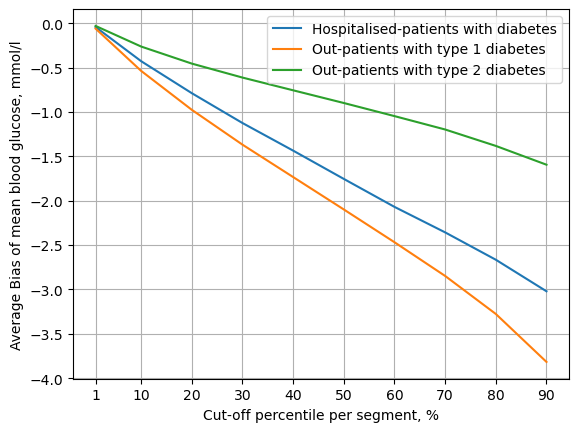

In [44]:
plt.figure()
plt.plot(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100, biases1_BG, label='Hospitalised-patients with diabetes')
plt.plot(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100, biases2_BG, label='Out-patients with type 1 diabetes')
plt.plot(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100, biases3_BG, label='Out-patients with type 2 diabetes')
# plt.title("Mean blood glucose bias for different cut-offs between right-censored data and original data")
plt.xticks(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100)  # Optional: Rotate for better readability
plt.xlabel("Cut-off percentile per segment, %")
plt.ylabel("Average Bias of mean blood glucose, mmol/l")
plt.grid(True)
plt.legend()
plt.show()

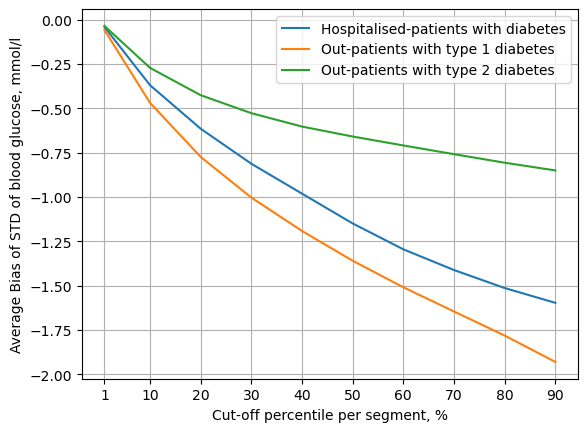

In [45]:
plt.figure()
plt.plot(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100, biases1_STD, label='Hospitalised-patients with diabetes')
plt.plot(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100, biases2_STD, label='Out-patients with type 1 diabetes')
plt.plot(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100, biases3_STD, label='Out-patients with type 2 diabetes')
# plt.title("Mean blood glucose bias for different cut-offs between right-censored data and original data")
plt.xticks(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100)  # Optional: Rotate for better readability
plt.xlabel("Cut-off percentile per segment, %")
plt.ylabel("Average Bias of STD of blood glucose, mmol/l")
plt.legend()
plt.grid(True)
plt.show()

Calculate metrics for each percentile per dataset

In [18]:
def calculate_meanBG1(dataset = 'iso', method = 'gp', kernel = 'matern32', percentile = 0.8):
    if dataset == "ohio":
        patient_ids = [
            "540",
            "544",
            "552",
            "559",
            "563",
            "567",
            "570",
            "575",
            "584",
            "588",
            "591",
            "596",
        ]
        train_data_dict = {}
        test_data_dict = {}
        all_data_dict = {}
        for patient_id in patient_ids:
            _, train_data, test_data, all_data = load_data_ohio(
                patient_id, include_test=True
            )
            train_data_dict[patient_id] = train_data
            test_data_dict[patient_id] = test_data
            all_data_dict[patient_id] = all_data
    elif dataset == "iso":
        patient_ids = [str(i) for i in range(102, 224)]
        to_remove = [
            "103",
            "108",
            "110",
            "113",
            "115",
            "116",  # Not sure yet
            "122",
            "126",
            "127",
            "128",
            "130",
            "134",
            "139",
            "143",
            "144",
            "146",
            "149",
            "152",
            "155",
            "156",
            "164",
            "174",
            "175",
            "176",
            "177",
            "180",
            "185",
            "186",
            "190",
            "193",
            "194",
            "197",
            "203",
            "206",
            "211",
            "212",
            "220",
        ]
        patient_ids = list(set(patient_ids) - set(to_remove))
        all_data_dict = {}

        for patient_id in patient_ids:
            all_data = load_data_iso(patient_id)
            all_data_dict[patient_id] = all_data

        patient_ids_cap = ["620"]
        patient_ids_cap1 = [
            "627",
            "639",
            "652",
            "675",
            "CGM_007",
            "CGM_008",
            "CGM_009",
            "CGM_011",
            "CGM_013",
            "CGM_014",
            "CGM_017",
            "CGM_018",
            "CGM_020",
            "CGM_021",
            "CGM_022",
            "CGM_023",
            "CGM_024",
            "CGM_025",
        ]
        for patient_id in patient_ids_cap:
            all_data = load_data_cap(patient_id)
            all_data_dict[patient_id] = all_data

        for patient_id in patient_ids_cap1:
            all_data = load_data_cap1(patient_id)
            all_data_dict[patient_id] = all_data

        patient_ids = patient_ids + patient_ids_cap + patient_ids_cap1

    elif (
        dataset == "iglu"
        or dataset == "dubosson"
        or dataset == "weinstock"
        or dataset == "colas"
        or dataset == "hall"
        or dataset == "T1DEXI_adults"
    ):
        all_data_dict, patient_ids = load_data_glucobench(dataset)
    elif dataset == "t1d":
        patient_id_ohio = [
            "540",
            "544",
            "552",
            "559",
            "563",
            "567",
            "570",
            "575",
            "584",
            "588",
            "591",
            "596",
        ]
        train_data_dict = {}
        test_data_dict = {}
        all_data_dict = {}
        # Update patient ids to be unique for Ohio dataset
        for patient_id in patient_id_ohio:
            unique_patient_id = f"ohio_{patient_id}"  # Add a prefix to make it unique
            _, train_data, test_data, all_data = load_data_ohio(
                patient_id, include_test=True
            )

            train_data_dict[unique_patient_id] = train_data
            test_data_dict[unique_patient_id] = test_data
            all_data_dict[unique_patient_id] = all_data

        # Update patient ids to be unique for Dubosson dataset
        all_data_dubosson, patient_id_dubosson = load_data_glucobench("dubosson")
        for patient_id in patient_id_dubosson:
            unique_patient_id = f"dubosson_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_dubosson[patient_id]

        # Update patient ids to be unique for Weinstock dataset
        all_data_weinstock, patient_id_weinstock = load_data_glucobench("weinstock")
        for patient_id in patient_id_weinstock:
            unique_patient_id = f"weinstock_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_weinstock[patient_id]

        # Update patient ids to be unique for T1DEXI_adults dataset
        all_data_t1dexi, patient_id_t1dexi = load_data_glucobench("T1DEXI_adults")
        for patient_id in patient_id_t1dexi:
            unique_patient_id = (
                f"T1DEXI_adults_{patient_id}"  # Add a prefix for uniqueness
            )
            all_data_dict[unique_patient_id] = all_data_t1dexi[patient_id]

        # Create a list of all unique patient IDs from all datasets
        patient_ids = (
            [f"ohio_{id}" for id in patient_id_ohio]
            + [f"weinstock_{id}" for id in patient_id_weinstock]
            + [f"dubosson_{id}" for id in patient_id_dubosson]
            + [f"T1DEXI_adults_{id}" for id in patient_id_t1dexi]
        )
    elif dataset == "t2d":
        all_data_dict = {}
        all_data_colas, patient_id_colas = load_data_glucobench("colas")
        print(patient_id_colas)
        for patient_id in patient_id_colas:
            unique_patient_id = f"colas_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_colas[patient_id]

        all_data_iglu, patient_id_iglu = load_data_glucobench("iglu")
        print(patient_id_iglu)
        for patient_id in patient_id_iglu:
            unique_patient_id = f"iglu_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_iglu[patient_id]

        all_data_hall, patient_id_hall = load_data_glucobench("hall")
        print(patient_id_hall)
        for patient_id in patient_id_hall:
            unique_patient_id = f"hall_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_hall[patient_id]

        # Create a list of all unique patient IDs from all datasets
        patient_ids = (
            [f"colas_{id}" for id in patient_id_colas]
            + [f"iglu_{id}" for id in patient_id_iglu]
            + [f"hall_{id}" for id in patient_id_hall]
        )

    # 1. create continues
    cont_segments_dict = {}
    filtered_segments_dict = {}

    for patient_id in patient_ids:
        patient_data = all_data_dict
        cont_segments_loc = get_daily_segments_loc(
            {patient_id: patient_data[patient_id]}, "cbg"
        )
        cont_segments_dict[patient_id] = cont_segments_loc[patient_id]
        filtered_segments = check_and_filter_nan_segments(
            patient_data[patient_id], cont_segments_dict[patient_id], "cbg"
        )
        filtered_segments_dict[patient_id] = filtered_segments

    # Initialize a new dictionary to store the segmented data per patient
    segmented_data_dict = {}
    segment_stats_dict = {}
    # Loop over each patient and extract their segments based on the filtered indices
    for patient_id, filtered_segments in filtered_segments_dict.items():
        # Get the start indices for the patient's filtered segments
        start_indices = filtered_segments["start_indices"]
        end_indices = filtered_segments["end_indices"]

        # Extract the corresponding data for each segment
        patient_data = all_data_dict[
            patient_id
        ]  # Assuming this is the full data for the patient

        # Initialize a list to store the segmented data for the patient
        patient_segments = []
        patient_segment_stats = []

        # Loop over the start indices to slice the data for each segment
        for i in range(
            len(start_indices)
        ):  # Loop until the second-to-last index (since we're using pairs)
            start_idx = start_indices[i]
            end_idx = end_indices[i]

            # Extract the segment for this pair of indices
            segment_data = patient_data[start_idx : end_idx + 1]["cbg"]

            # Calculate the length of the segment
            segment_length = len(segment_data)

            # Count the number of NaN values in the segment
            num_nan_values = np.sum(np.isnan(segment_data))

            if segment_length == 288:
                # print(f"The segment has {num_nan_values} NaN values.")
                # Append the segment to the patient's list of segments
                patient_segments.append(np.array(segment_data))

                # Store the statistics (length and NaN count) for this segment
                patient_segment_stats.append(
                    {"segment_length": segment_length, "num_nan_values": num_nan_values}
                )
        if len(patient_segments) != 0:
            # Store the segmented data in the dictionary, using the patient_id as the key
            segmented_data_dict[patient_id] = patient_segments
            segment_stats_dict[patient_id] = patient_segment_stats

    original_segments = segmented_data_dict
    
    original_dataset = {}
    for patient_id, segments in original_segments.items():
        original_dataset[patient_id] = np.concatenate(original_segments[patient_id])

    
    censored_dataset = {}
    for patient_id, segment in original_dataset.items():
        thresh = np.quantile(segment[~np.isnan(segment)], percentile)
        censored_dataset[patient_id] = np.where(segment > thresh, np.nan, segment)
    

    bias_after_BG = []
    bias_after_STD = []
    meanBG_censored = []
    meanBG_original = []
    meanSTD_censored = []
    meanSTD_original = []
    for patient_id, segments in original_dataset.items():
        meanBG_censored.append(np.nanmean(censored_dataset[patient_id]))
        meanBG_original.append(np.nanmean(original_dataset[patient_id]))
        meanSTD_censored.append(np.nanstd(censored_dataset[patient_id]))
        meanSTD_original.append(np.nanstd(original_dataset[patient_id]))
        bias_after_BG.append(
        np.nanmean(censored_dataset[patient_id]) - np.nanmean(original_dataset[patient_id])
        )
        bias_after_STD.append(
        np.nanstd(censored_dataset[patient_id]) - np.nanstd(original_dataset[patient_id])
        )
        
    return bias_after_BG, bias_after_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original

In [19]:
from scipy.stats import ttest_rel
from scipy.stats import ttest_ind
from scipy.stats import shapiro
from scipy.stats import wilcoxon

biases1_BG = []
biases1_STD = []
mean1_BG_censored = []
mean1_BG_original = []
for i in np.arange(0.1, 1, 0.1):
    print("PERCENTILE = ", i)
    bias1_BG, bias1_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original = calculate_meanBG1(percentile=i)
    
    biases1_BG.append(np.mean(bias1_BG))
    biases1_STD.append(np.mean(bias1_STD))
    mean1_BG_censored.append(meanBG_censored)
    mean1_BG_original.append(meanBG_original)

    differences = [o - c for o, c in zip(meanBG_censored, meanBG_original)]
    stat, p = shapiro(differences)
    if p < 0.05:
        print("Differences are not normally distributed.")
        # Perform Wilcoxon signed-rank test
        stat, p_value = wilcoxon(meanBG_original, meanBG_censored)

        # Interpret the result
        if p_value < 0.05:
            print("The difference between original and censored data is statistically significant.")
        else:
            print("The difference between original and censored data is not statistically significant.")
    else:
        print("Differences are normally distributed.")
        t_stat, p_value = ttest_rel(meanBG_original, meanBG_censored)
        # Check significance
        if p_value < 0.05:
            print("The difference between original and censored data is statistically significant.")
        else:
            print("The difference between original and censored data is not statistically significant.")
    
print("PERCENTILE = 0.99")
bias1_BG, bias1_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original = calculate_meanBG1(percentile=0.99)
biases1_BG.append(np.mean(bias1_BG))
biases1_STD.append(np.mean(bias1_STD))
mean1_BG_censored.append(meanBG_censored)
mean1_BG_original.append(meanBG_original)
print(meanBG_censored)
print(meanBG_original)
differences = [o - c for o, c in zip(meanBG_censored, meanBG_original)]
stat, p = shapiro(differences)
if p < 0.05:
    print("Differences are not normally distributed.")
    # Perform Wilcoxon signed-rank test
    stat, p_value = wilcoxon(meanBG_original, meanBG_censored)

    # Interpret the result
    if p_value < 0.05:
        print("The difference between original and censored data is statistically significant.")
    else:
        print("The difference between original and censored data is not statistically significant.")
else:
    print("Differences are normally distributed.")
    t_stat, p_value = ttest_rel(meanBG_original, meanBG_censored)
    # Check significance
    if p_value < 0.05:
        print("The difference between original and censored data is statistically significant.")
    else:
        print("The difference between original and censored data is not statistically significant.")



PERCENTILE =  0.1
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.2
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.30000000000000004
Differences are normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.4
Differences are normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.5
Differences are normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.6
Differences are normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.7000000000000001
Differences are normally distributed.
The difference between original and censored data is statistically significant.
PERCENTIL

In [20]:
from scipy.stats import ttest_rel
from scipy.stats import ttest_ind
from scipy.stats import shapiro
from scipy.stats import wilcoxon

biases2_BG = []
biases2_STD = []
mean2_BG_censored = []
mean2_BG_original = []
for i in np.arange(0.1, 1, 0.1):
    print("PERCENTILE = ", i)
    bias2_BG, bias2_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original = calculate_meanBG1(dataset='t1d', percentile=i)
    
    biases2_BG.append(np.mean(bias2_BG))
    biases2_STD.append(np.mean(bias2_STD))
    mean2_BG_censored.append(meanBG_censored)
    mean2_BG_original.append(meanBG_original)

    differences = [o - c for o, c in zip(meanBG_censored, meanBG_original)]
    stat, p = shapiro(differences)
    if p < 0.05:
        print("Differences are not normally distributed.")
        # Perform Wilcoxon signed-rank test
        stat, p_value = wilcoxon(meanBG_original, meanBG_censored)

        # Interpret the result
        if p_value < 0.05:
            print("The difference between original and censored data is statistically significant.")
        else:
            print("The difference between original and censored data is not statistically significant.")
    else:
        print("Differences are normally distributed.")
        t_stat, p_value = ttest_rel(meanBG_original, meanBG_censored)
        # Check significance
        if p_value < 0.05:
            print("The difference between original and censored data is statistically significant.")
        else:
            print("The difference between original and censored data is not statistically significant.")
    
print("PERCENTILE = 0.99")
bias2_BG, bias2_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original = calculate_meanBG1(dataset='t1d', percentile=0.99)
biases2_BG.append(np.mean(bias2_BG))
biases2_STD.append(np.mean(bias2_STD))
mean2_BG_censored.append(meanBG_censored)
mean2_BG_original.append(meanBG_original)
print(meanBG_censored)
print(meanBG_original)
differences = [o - c for o, c in zip(meanBG_censored, meanBG_original)]
stat, p = shapiro(differences)
if p < 0.05:
    print("Differences are not normally distributed.")
    # Perform Wilcoxon signed-rank test
    stat, p_value = wilcoxon(meanBG_original, meanBG_censored)

    # Interpret the result
    if p_value < 0.05:
        print("The difference between original and censored data is statistically significant.")
    else:
        print("The difference between original and censored data is not statistically significant.")
else:
    print("Differences are normally distributed.")
    t_stat, p_value = ttest_rel(meanBG_original, meanBG_censored)
    # Check significance
    if p_value < 0.05:
        print("The difference between original and censored data is statistically significant.")
    else:
        print("The difference between original and censored data is not statistically significant.")



PERCENTILE =  0.1
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.2
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.30000000000000004
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.4
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.5
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.6
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.7000000000000001
Differences are not normally distributed.
The difference between original and censored data is statistically si

In [21]:
from scipy.stats import ttest_rel
from scipy.stats import ttest_ind
from scipy.stats import shapiro
from scipy.stats import wilcoxon

biases3_BG = []
biases3_STD = []
mean3_BG_censored = []
mean3_BG_original = []
for i in np.arange(0.1, 1, 0.1):
    print("PERCENTILE = ", i)
    bias3_BG, bias3_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original = calculate_meanBG1(dataset='t2d', percentile=i)
    
    biases3_BG.append(np.mean(bias3_BG))
    biases3_STD.append(np.mean(bias3_STD))
    mean3_BG_censored.append(meanBG_censored)
    mean3_BG_original.append(meanBG_original)

    differences = [o - c for o, c in zip(meanBG_censored, meanBG_original)]
    stat, p = shapiro(differences)
    if p < 0.05:
        print("Differences are not normally distributed.")
        # Perform Wilcoxon signed-rank test
        stat, p_value = wilcoxon(meanBG_original, meanBG_censored)

        # Interpret the result
        if p_value < 0.05:
            print("The difference between original and censored data is statistically significant.")
        else:
            print("The difference between original and censored data is not statistically significant.")
    else:
        print("Differences are normally distributed.")
        t_stat, p_value = ttest_rel(meanBG_original, meanBG_censored)
        # Check significance
        if p_value < 0.05:
            print("The difference between original and censored data is statistically significant.")
        else:
            print("The difference between original and censored data is not statistically significant.")
    
print("PERCENTILE = 0.99")
bias3_BG, bias3_STD, meanBG_censored, meanBG_original, meanSTD_censored, meanSTD_original = calculate_meanBG1(dataset='t2d', percentile=0.99)
biases3_BG.append(np.mean(bias3_BG))
biases3_STD.append(np.mean(bias3_STD))
mean3_BG_censored.append(meanBG_censored)
mean3_BG_original.append(meanBG_original)
print(meanBG_censored)
print(meanBG_original)
differences = [o - c for o, c in zip(meanBG_censored, meanBG_original)]
stat, p = shapiro(differences)
if p < 0.05:
    print("Differences are not normally distributed.")
    # Perform Wilcoxon signed-rank test
    stat, p_value = wilcoxon(meanBG_original, meanBG_censored)

    # Interpret the result
    if p_value < 0.05:
        print("The difference between original and censored data is statistically significant.")
    else:
        print("The difference between original and censored data is not statistically significant.")
else:
    print("Differences are normally distributed.")
    t_stat, p_value = ttest_rel(meanBG_original, meanBG_censored)
    # Check significance
    if p_value < 0.05:
        print("The difference between original and censored data is statistically significant.")
    else:
        print("The difference between original and censored data is not statistically significant.")



PERCENTILE =  0.1
dict_keys(['121', '153', '155', '157', '161', '172', '185', '191', '195', '22', '23', '25', '28', '31', '56', '86', '93'])
dict_keys(['Subject 1', 'Subject 2', 'Subject 3', 'Subject 4', 'Subject 5'])
dict_keys(['1636-69-001', '1636-69-091', '2133-004', '2133-018', '2133-039'])
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.2
dict_keys(['121', '153', '155', '157', '161', '172', '185', '191', '195', '22', '23', '25', '28', '31', '56', '86', '93'])
dict_keys(['Subject 1', 'Subject 2', 'Subject 3', 'Subject 4', 'Subject 5'])
dict_keys(['1636-69-001', '1636-69-091', '2133-004', '2133-018', '2133-039'])
Differences are not normally distributed.
The difference between original and censored data is statistically significant.
PERCENTILE =  0.30000000000000004
dict_keys(['121', '153', '155', '157', '161', '172', '185', '191', '195', '22', '23', '25', '28', '31', '56', '86', '93'])
dict_ke

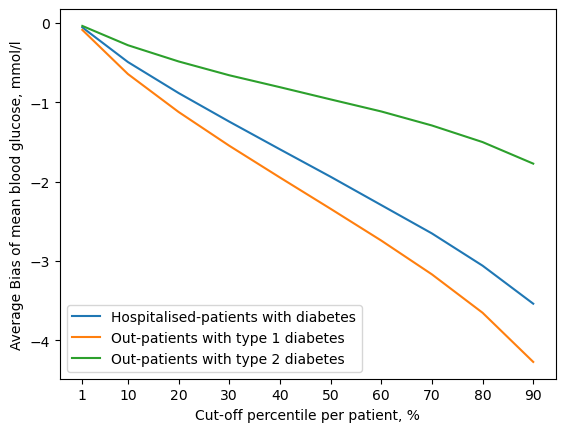

In [35]:
plt.figure()
plt.plot(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100, biases1_BG, label='Hospitalised-patients with diabetes')
plt.plot(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100, biases2_BG, label='Out-patients with type 1 diabetes')
plt.plot(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100, biases3_BG, label='Out-patients with type 2 diabetes')
# plt.title("Mean blood glucose bias for different cut-offs between right-censored data and original data")
plt.xticks(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100)  # Optional: Rotate for better readability
plt.xlabel("Cut-off percentile per patient, %")
plt.ylabel("Average Bias of mean blood glucose, mmol/l")
plt.legend()
plt.show()

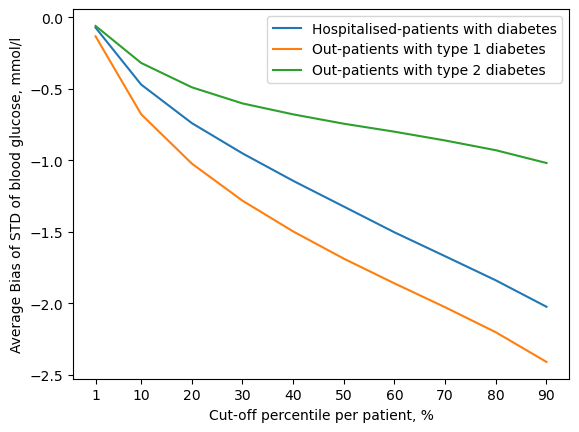

In [36]:
plt.figure()
plt.plot(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100, biases1_STD, label='Hospitalised-patients with diabetes')
plt.plot(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100, biases2_STD, label='Out-patients with type 1 diabetes')
plt.plot(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100, biases3_STD, label='Out-patients with type 2 diabetes')
# plt.title("Mean blood glucose bias for different cut-offs between right-censored data and original data")
plt.xticks(100-np.append(np.arange(0.1, 1, 0.1),0.99)*100)  # Optional: Rotate for better readability
plt.xlabel("Cut-off percentile per patient, %")
plt.ylabel("Average Bias of STD of blood glucose, mmol/l")
plt.legend()
plt.show()

Real-Life example

In [4]:
# Get the parent directory path
parent_dir = os.path.abspath(os.path.join(os.getcwd(), ".."))
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)
    
from src.data_processing import find_intervals_more_than_15_and_fill

def load_data_glucobench(dataset_name):
    """Loads training data from the 2018 and 2020 datasets.
    Optionally includes test data, but only for final evaluation.
    Returns both raw (unmodified) and processed (with elapsed time columns) data."""

    path = "C:/PhD/codeAIHN/imputation_OOR/data/" + str(dataset_name) + ".csv"

    data = pd.read_csv(path)
    data.rename(columns={"time": "Tid", "gl": "cbg"}, inplace=True)
    data["cbg"] = data["cbg"] * 0.0555
    data["id"] = data["id"].astype(str)

    if dataset_name == "colas":
        # Keep only rows where the T2DM column is True
        data = data[data["T2DM"] == True].copy()
    elif dataset_name == "hall":
        data = data[data["diagnosis"] == 2].copy()

    # Initialize an empty dictionary to store DataFrames for each patient
    all_data_dict = {}

    # Iterate over the unique patient IDs in the DataFrame
    for patient_id in data["id"].unique():
        # Filter the DataFrame for the current patient_id
        patient_data = data[data["id"] == patient_id].copy()

        # Ensure "Tid" is in datetime format for proper processing
        patient_data["Tid"] = pd.to_datetime(patient_data["Tid"])

        # Sort the DataFrame by "Tid"
        patient_data.sort_values(by="Tid", inplace=True)
        patient_data.reset_index(drop=True, inplace=True)  # Reset the index

        # Format "Tid" back to the desired string format if needed
        patient_data["Tid"] = patient_data["Tid"].dt.strftime("%d/%m/%Y %H:%M")

        patient_data = find_intervals_more_than_15_and_fill(patient_data)
        patient_data["minutes_elapsed"] = np.arange(0, len(patient_data) * 5, 5)
        patient_data["days_elapsed"] = patient_data["minutes_elapsed"] / 1440

        if len(patient_data) >= 288:
            # Store the patient-specific DataFrame in the dictionary
            all_data_dict[patient_id] = patient_data

    return all_data_dict, all_data_dict.keys()


In [22]:
def visualize_original_interpolated(
    interpolated_segments,
    cleaned_censored_segments,
    cleaned_original_segments,
    dataset,
    method_name="Polynomian",
    
):
    """Visualize original and interpolated test data segments for each patient."""

    for i, patient_id in enumerate(cleaned_original_segments.keys()):
        fig, axes = plt.subplots(
            nrows=1,
            ncols=2,
            figsize=(
                20,
                5,
            ),
        )
        axes = axes.flatten()

        if len(cleaned_original_segments[patient_id]) > 1:
            original_segment = np.concatenate(cleaned_censored_segments[patient_id])
            interpolated_segment = np.concatenate(interpolated_segments[patient_id])
            original_patient_data = np.concatenate(
                cleaned_original_segments[patient_id]
            )
        else:
            original_segment = cleaned_censored_segments[patient_id][0]
            interpolated_segment = interpolated_segments[patient_id][0]
            original_patient_data = cleaned_original_segments[patient_id][0]


        y_min = min(np.nanmin(interpolated_segment), np.nanmin(original_patient_data))
        y_max = max(np.nanmax(interpolated_segment), np.nanmax(original_patient_data))

        axes[1].plot(
            interpolated_segment, color="orange", label="Interpolated Data", alpha=0.8
        )
        axes[1].plot(original_segment, color="purple", label="Original Data")
        axes[1].set_ylim([y_min, y_max])  # Set shared y-axis limits
        axes[1].set_title(
            f"Participant {patient_id} | {method_name} on Original Data"
        )
        axes[1].set_xlabel("Time (minutes)")
        axes[1].set_ylabel("CGM (mmol/L)")
        axes[1].grid(True)

        axes[0].plot(original_patient_data, color="purple")
        axes[0].set_ylim([y_min, y_max])  # Set shared y-axis limits
        axes[0].set_title(
            f"Real-Life Example from Participant {patient_id}"
        )
        axes[0].set_xlabel("Time (minutes)")
        axes[0].set_ylabel("CGM (mmol/L)")
        axes[0].grid(True)
        
        plt.tight_layout()
        os.makedirs(
            f"C:/PhD/codeAIHN\imputation_OOR/figures/paper/real_life_example",
            exist_ok=True,
        )
        plt.savefig(
            f"C:/PhD/codeAIHN/imputation_OOR/figures/paper/real_life_example/real_life_example_{dataset}{patient_id}.png"
        )
        plt.show()

        plt.close()


   

In [18]:
# Get the parent directory path
parent_dir = os.path.abspath(os.path.join(os.getcwd(), ".."))
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)
    

from src.data_processing import (
    get_daily_segments_loc,
    check_and_filter_nan_segments,
)
from src.data_loaders import (
    load_data_iso,
    load_data_cap,
    load_data_cap1,
    load_data_ohio,
)

from models.baselines import naive_baseline_imputation
from models.gp import train_gpr, inference_gpr
from src.bg_statistics import compare_statistics

def main(dataset = 'iso', method = 'gp', kernel = 'matern32', percentile = 0.8):
    # Step 1: Load data
    print("Loading data...")
    if dataset == "ohio":
        patient_ids = [
            "540",
            "544",
            "552",
            "559",
            "563",
            "567",
            "570",
            "575",
            "584",
            "588",
            "591",
            "596",
        ]
        train_data_dict = {}
        test_data_dict = {}
        all_data_dict = {}
        for patient_id in patient_ids:
            _, train_data, test_data, all_data = load_data_ohio(
                patient_id, include_test=True
            )
            train_data_dict[patient_id] = train_data
            test_data_dict[patient_id] = test_data
            all_data_dict[patient_id] = all_data
    elif dataset == "iso":
        patient_ids = [str(i) for i in range(102, 224)]
        to_remove = [
            "103",
            "108",
            "110",
            "113",
            "115",
            "116",  # Not sure yet
            "122",
            "126",
            "127",
            "128",
            "130",
            "134",
            "139",
            "143",
            "144",
            "146",
            "149",
            "152",
            "155",
            "156",
            "164",
            "174",
            "175",
            "176",
            "177",
            "180",
            "185",
            "186",
            "190",
            "193",
            "194",
            "197",
            "203",
            "206",
            "211",
            "212",
            "220",
        ]
        patient_ids = list(set(patient_ids) - set(to_remove))
        all_data_dict = {}

        for patient_id in patient_ids:
            all_data = load_data_iso(patient_id)
            all_data_dict[patient_id] = all_data

        patient_ids_cap = ["620"]
        patient_ids_cap1 = [
            "627",
            "639",
            "652",
            "675",
            "CGM_007",
            "CGM_008",
            "CGM_009",
            "CGM_011",
            "CGM_013",
            "CGM_014",
            "CGM_017",
            "CGM_018",
            "CGM_020",
            "CGM_021",
            "CGM_022",
            "CGM_023",
            "CGM_024",
            "CGM_025",
        ]
        for patient_id in patient_ids_cap:
            all_data = load_data_cap(patient_id)
            all_data_dict[patient_id] = all_data

        for patient_id in patient_ids_cap1:
            all_data = load_data_cap1(patient_id)
            all_data_dict[patient_id] = all_data

        patient_ids = patient_ids + patient_ids_cap + patient_ids_cap1

    elif (
        dataset == "iglu"
        or dataset == "dubosson"
        or dataset == "weinstock"
        or dataset == "colas"
        or dataset == "hall"
        or dataset == "T1DEXI_adults"
    ):
        all_data_dict, patient_ids = load_data_glucobench(dataset)
    elif dataset == "t1d":
        patient_id_ohio = [
            "540",
            "544",
            "552",
            "559",
            "563",
            "567",
            "570",
            "575",
            "584",
            "588",
            "591",
            "596",
        ]
        train_data_dict = {}
        test_data_dict = {}
        all_data_dict = {}
        # Update patient ids to be unique for Ohio dataset
        for patient_id in patient_id_ohio:
            unique_patient_id = f"ohio_{patient_id}"  # Add a prefix to make it unique
            _, train_data, test_data, all_data = load_data_ohio(
                patient_id, include_test=True
            )

            train_data_dict[unique_patient_id] = train_data
            test_data_dict[unique_patient_id] = test_data
            all_data_dict[unique_patient_id] = all_data

        # Update patient ids to be unique for Dubosson dataset
        all_data_dubosson, patient_id_dubosson = load_data_glucobench("dubosson")
        for patient_id in patient_id_dubosson:
            unique_patient_id = f"dubosson_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_dubosson[patient_id]

        # Update patient ids to be unique for Weinstock dataset
        all_data_weinstock, patient_id_weinstock = load_data_glucobench("weinstock")
        for patient_id in patient_id_weinstock:
            unique_patient_id = f"weinstock_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_weinstock[patient_id]

        # Update patient ids to be unique for T1DEXI_adults dataset
        all_data_t1dexi, patient_id_t1dexi = load_data_glucobench("T1DEXI_adults")
        for patient_id in patient_id_t1dexi:
            unique_patient_id = (
                f"T1DEXI_adults_{patient_id}"  # Add a prefix for uniqueness
            )
            all_data_dict[unique_patient_id] = all_data_t1dexi[patient_id]

        # Create a list of all unique patient IDs from all datasets
        patient_ids = (
            [f"ohio_{id}" for id in patient_id_ohio]
            + [f"weinstock_{id}" for id in patient_id_weinstock]
            + [f"dubosson_{id}" for id in patient_id_dubosson]
            + [f"T1DEXI_adults_{id}" for id in patient_id_t1dexi]
        )
    elif dataset == "t2d":
        all_data_dict = {}
        all_data_colas, patient_id_colas = load_data_glucobench("colas")
        print(patient_id_colas)
        for patient_id in patient_id_colas:
            unique_patient_id = f"colas_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_colas[patient_id]

        all_data_iglu, patient_id_iglu = load_data_glucobench("iglu")
        print(patient_id_iglu)
        for patient_id in patient_id_iglu:
            unique_patient_id = f"iglu_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_iglu[patient_id]

        all_data_hall, patient_id_hall = load_data_glucobench("hall")
        print(patient_id_hall)
        for patient_id in patient_id_hall:
            unique_patient_id = f"hall_{patient_id}"  # Add a prefix for uniqueness
            all_data_dict[unique_patient_id] = all_data_hall[patient_id]

        # Create a list of all unique patient IDs from all datasets
        patient_ids = (
            [f"colas_{id}" for id in patient_id_colas]
            + [f"iglu_{id}" for id in patient_id_iglu]
            + [f"hall_{id}" for id in patient_id_hall]
        )

    # print("patient ids = ", patient_ids)
    # print("all data = ", all_data_dict)
        
    # 1. create continues
    cont_segments_dict = {}
    filtered_segments_dict = {}

    for patient_id in patient_ids:
        patient_data = all_data_dict
        cont_segments_loc = get_daily_segments_loc(
            {patient_id: patient_data[patient_id]}, "cbg"
        )
        cont_segments_dict[patient_id] = cont_segments_loc[patient_id]
        filtered_segments = check_and_filter_nan_segments(
            patient_data[patient_id], cont_segments_dict[patient_id], "cbg"
        )
        filtered_segments_dict[patient_id] = filtered_segments

    # Initialize a new dictionary to store the segmented data per patient
    segmented_data_dict = {}
    segment_stats_dict = {}
    # Loop over each patient and extract their segments based on the filtered indices
    for patient_id, filtered_segments in filtered_segments_dict.items():
        # Get the start indices for the patient's filtered segments
        start_indices = filtered_segments["start_indices"]
        end_indices = filtered_segments["end_indices"]

        # Extract the corresponding data for each segment
        patient_data = all_data_dict[
            patient_id
        ]  # Assuming this is the full data for the patient

        # Initialize a list to store the segmented data for the patient
        patient_segments = []
        patient_segment_stats = []

        # Loop over the start indices to slice the data for each segment
        for i in range(
            len(start_indices)
        ):  # Loop until the second-to-last index (since we're using pairs)
            start_idx = start_indices[i]
            end_idx = end_indices[i]

            # Extract the segment for this pair of indices
            segment_data = patient_data[start_idx : end_idx + 1]["cbg"]

            # Calculate the length of the segment
            segment_length = len(segment_data)

            # Count the number of NaN values in the segment
            num_nan_values = np.sum(np.isnan(segment_data))

            if segment_length == 288:
                # print(f"The segment has {num_nan_values} NaN values.")
                # Append the segment to the patient's list of segments
                patient_segments.append(np.array(segment_data))

                # Store the statistics (length and NaN count) for this segment
                patient_segment_stats.append(
                    {"segment_length": segment_length, "num_nan_values": num_nan_values}
                )
        if len(patient_segments) != 0:
            # Store the segmented data in the dictionary, using the patient_id as the key
            segmented_data_dict[patient_id] = patient_segments
            segment_stats_dict[patient_id] = patient_segment_stats

    original_segments = segmented_data_dict

    # keep the segments with values above range
    patients_to_remove = []
    for patient_id, segments in original_segments.items():
        original_segments[patient_id] = []
        for segment in segments:
            if any(y > 22.1 for y in segment):
                original_segments[patient_id].append(segment)
        if len(original_segments[patient_id]) == 0:
            patients_to_remove.append(patient_id)

    # Remove patients with no segments after filtering
    for patient_id in patients_to_remove:
        del original_segments[patient_id]
    
    
    # 2. censored segments
    # Dictionary for storing the interpolated data for each patient
    censored_segments = {}
    censored_segment_indices = {}

    # Assuming 'original_data' is a dictionary with patient data, and each entry is a 1D array of continuous data points
    for patient_id, segments in original_segments.items():
        # Store interpolated segments for the current patient
        censored_segments[patient_id] = []
        censored_segment_indices[patient_id] = []

        for segment in segments:
            if len(segment) != 288:
                print("segment len = ", len(segment))
            thresh =  22.1
            censored_segment = np.where(segment > thresh, np.nan, segment)
            censored_segment_index = np.where(segment > thresh)

            censored_segments[patient_id].append(censored_segment)
            censored_segment_indices[patient_id].append(censored_segment_index)


    # Now the cleaned_sensored_segments and cleaned_original_segments dictionaries
    # contain segments without leading or trailing NaN values, and they are aligned.
    # print("Cleaned Sensored Segments:", cleaned_sensored_segments)
    # print("Cleaned Original Segments:", cleaned_original_segments)
    if method == "polynomial":
        interpolated_segments_poly = naive_baseline_imputation(
            data=censored_segments, method="polynomial", order=2
        )
    elif method == "cubic":
        interpolated_segments_cubic = naive_baseline_imputation(
            data=censored_segments, method="cubic"
        )
    elif method == "ffill":
        interpolated_segments_ffill = naive_baseline_imputation(
            data=censored_segments, method="ffill"
        )
    elif method == "gp":
        scatter_plot = {}
        interpolated_segments_gp = {}
        for patient_id, segments in censored_segments.items():
            interpolated_segments_gp[patient_id] = []
            for i in range(len(segments)):
                # Convert segment to DataFrame to use interpolation functions
                segment_df = pd.DataFrame(segments[i], columns=["cbg"])
                # Check if there are any NaN values in the segment
                if segment_df["cbg"].isna().any():
                    ind_all = np.where(~np.isnan(np.array(segment_df)))[0]
                    var = np.std(np.array(segment_df)[ind_all]) ** 2
                    # Only train and infer if there are NaN values
                    gpr = train_gpr(np.array(segment_df), var=var, kernel=kernel)
                    indices, interpolated_segment, std = inference_gpr(
                        censored_segment_indices[patient_id][i][0], gpr
                    )

                    # Create a copy of the original segment and replace NaNs with interpolated values
                    indices = indices.flatten()  # Ensure `indices` is a flat array
                    full_interpolated_segment = np.array(segment_df).flatten().copy()

                    full_interpolated_segment[indices] = np.array(
                        interpolated_segment
                    ).flatten()  # Replace NaNs with interpolated values
                    interpolated_segments_gp[patient_id].append(
                        full_interpolated_segment
                    )

                    # plt.figure()
                    # plt.plot(full_interpolated_segment)
                    # plt.plot(np.array(segment_df).flatten().copy())

                else:
                    # If no NaN values, add the original segment without modification
                    interpolated_segments_gp[patient_id].append(
                        np.array(segment_df).flatten()
                    )
        visualize_original_interpolated(
        interpolated_segments_gp,
        censored_segments,
        original_segments,
        dataset,
        method_name="Gaussian Process",
        )
        


Loading data...


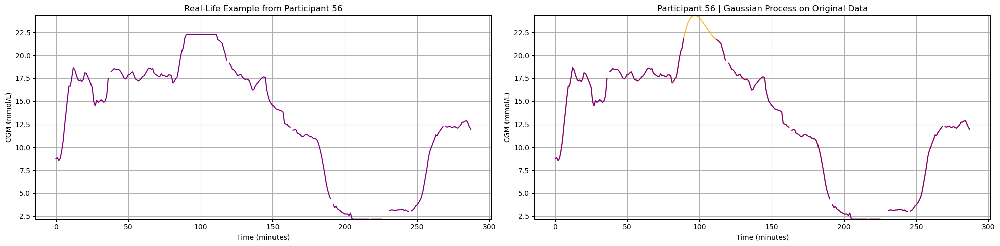

figures/paper/real_life_example/real_life_example_weinstock56.png


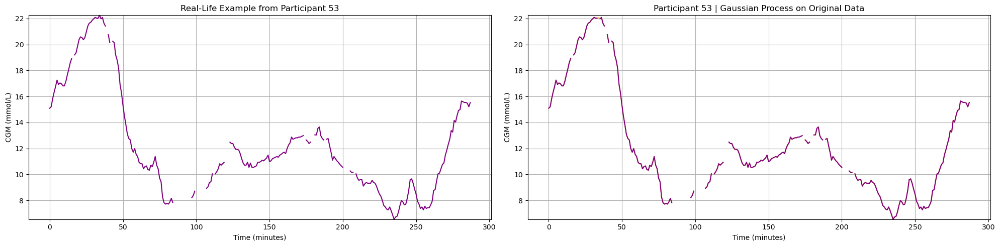

figures/paper/real_life_example/real_life_example_weinstock53.png


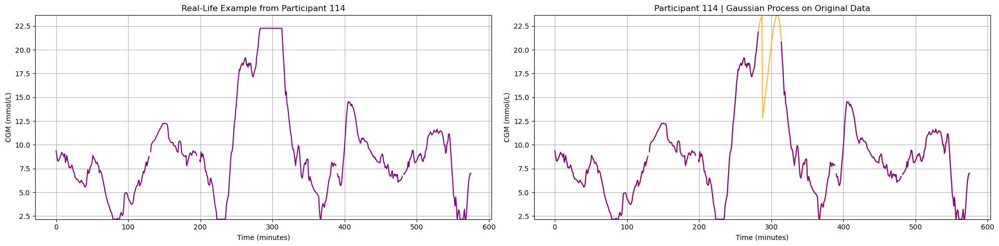

figures/paper/real_life_example/real_life_example_weinstock114.png


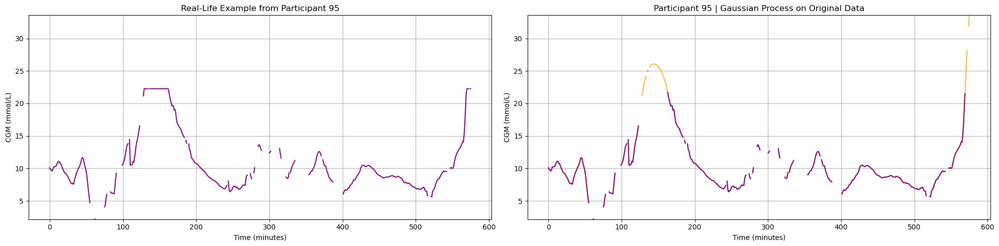

figures/paper/real_life_example/real_life_example_weinstock95.png


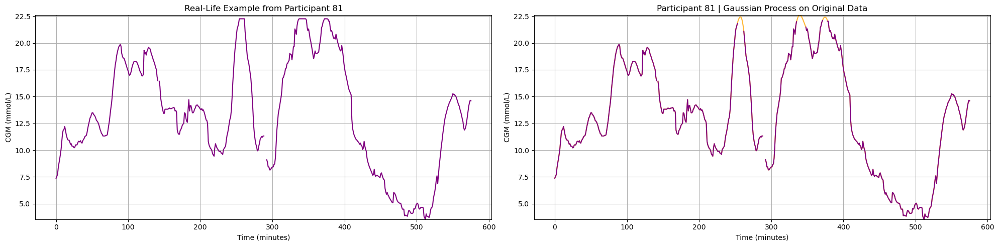

figures/paper/real_life_example/real_life_example_weinstock81.png


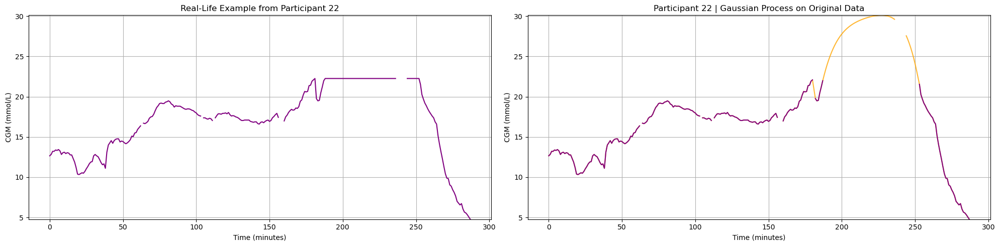

figures/paper/real_life_example/real_life_example_weinstock22.png


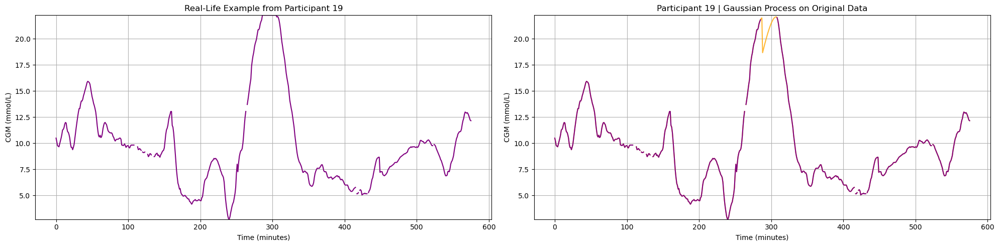

figures/paper/real_life_example/real_life_example_weinstock19.png


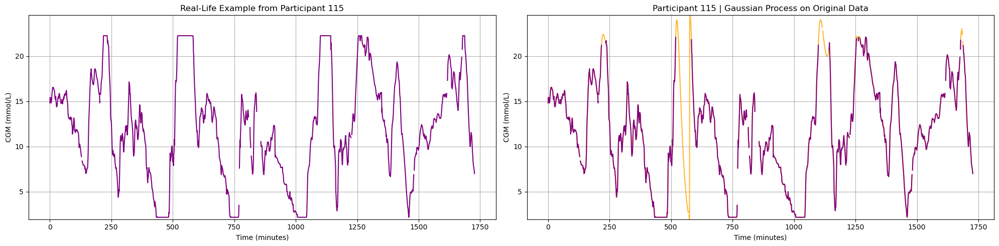

figures/paper/real_life_example/real_life_example_weinstock115.png


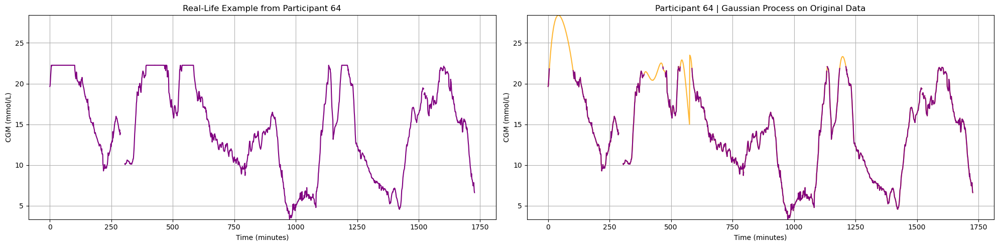

figures/paper/real_life_example/real_life_example_weinstock64.png


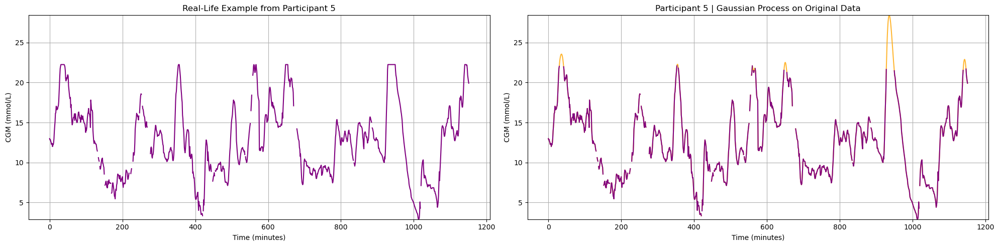

figures/paper/real_life_example/real_life_example_weinstock5.png


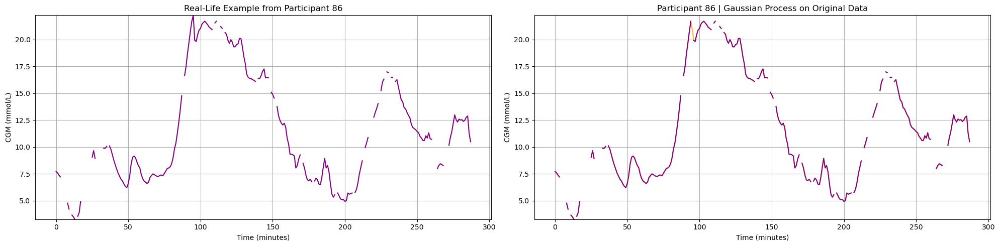

figures/paper/real_life_example/real_life_example_weinstock86.png


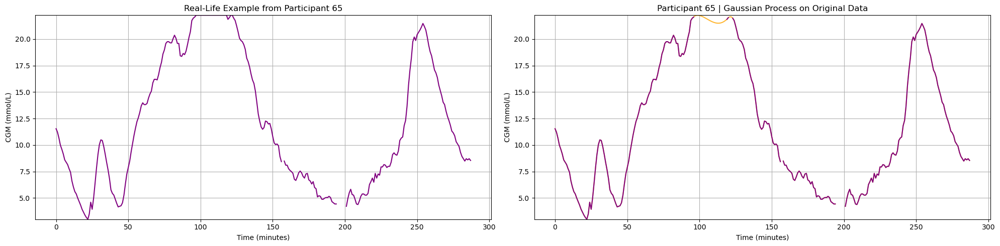

figures/paper/real_life_example/real_life_example_weinstock65.png


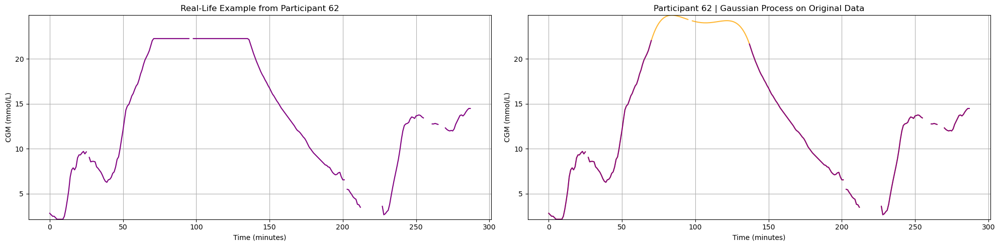

figures/paper/real_life_example/real_life_example_weinstock62.png


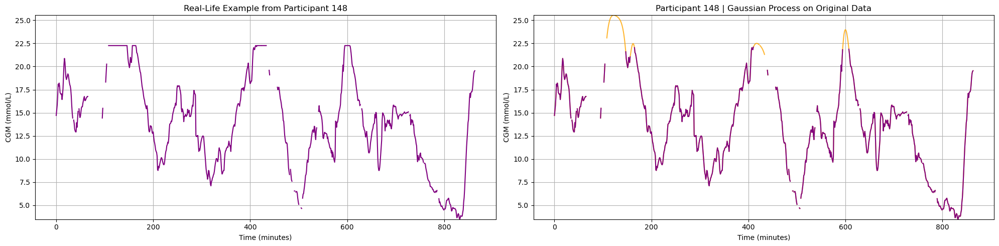

figures/paper/real_life_example/real_life_example_weinstock148.png


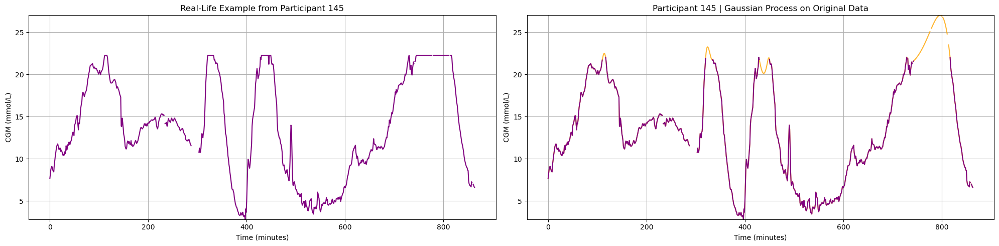

figures/paper/real_life_example/real_life_example_weinstock145.png


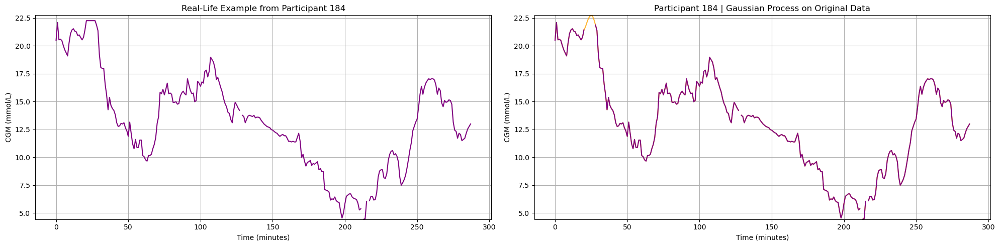

figures/paper/real_life_example/real_life_example_weinstock184.png


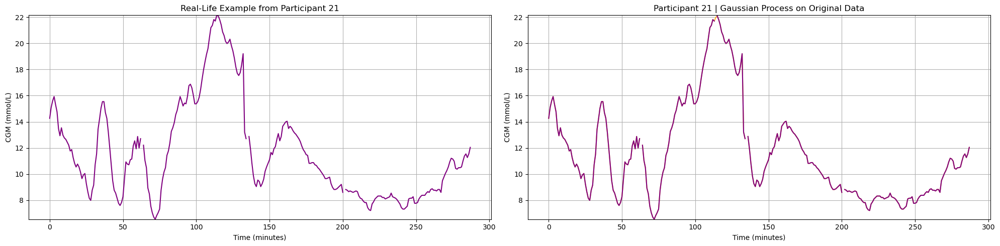

figures/paper/real_life_example/real_life_example_weinstock21.png


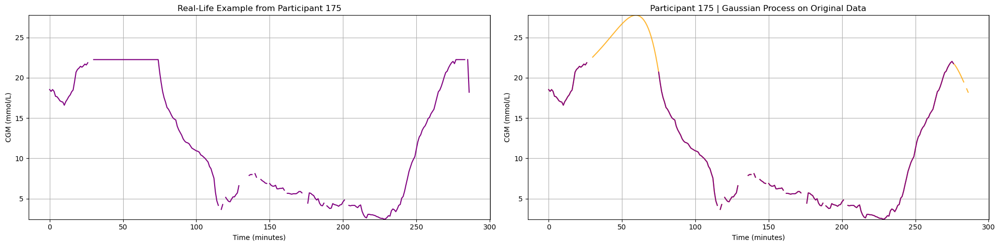

figures/paper/real_life_example/real_life_example_weinstock175.png


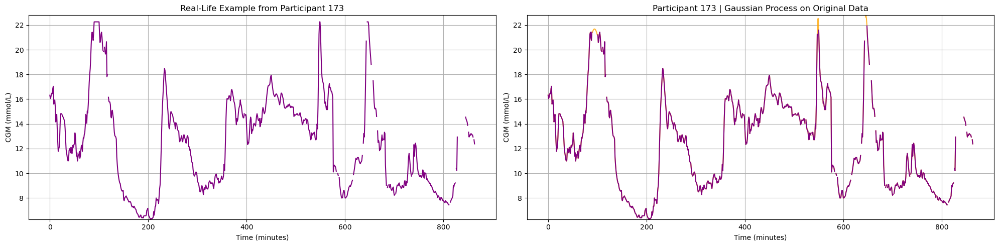

figures/paper/real_life_example/real_life_example_weinstock173.png


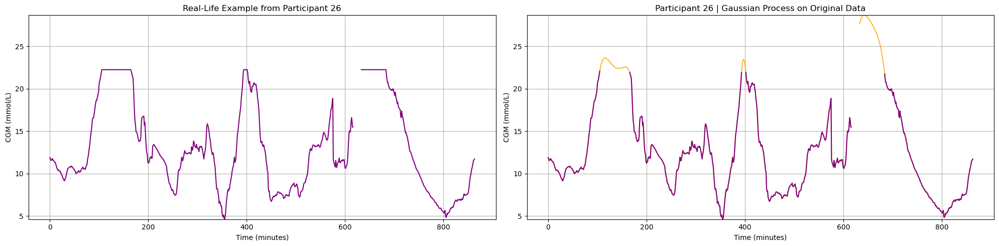

figures/paper/real_life_example/real_life_example_weinstock26.png


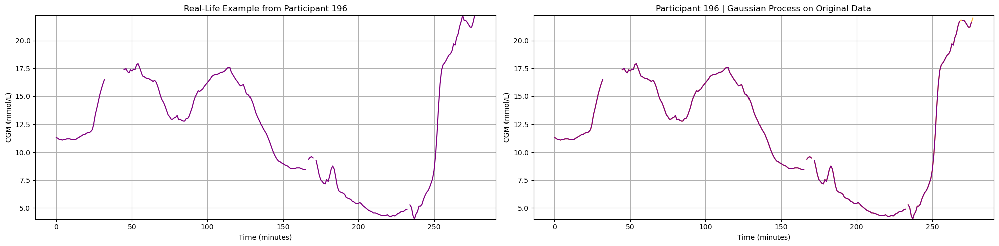

figures/paper/real_life_example/real_life_example_weinstock196.png


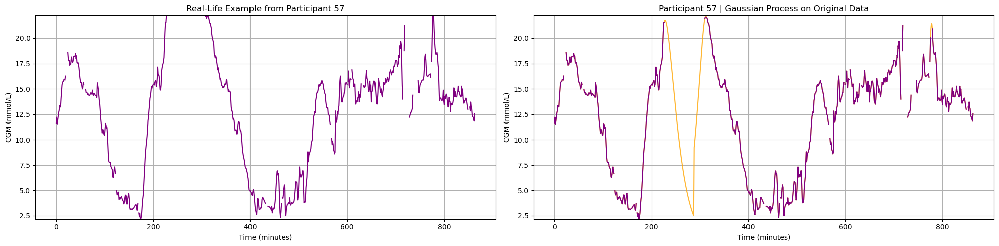

figures/paper/real_life_example/real_life_example_weinstock57.png


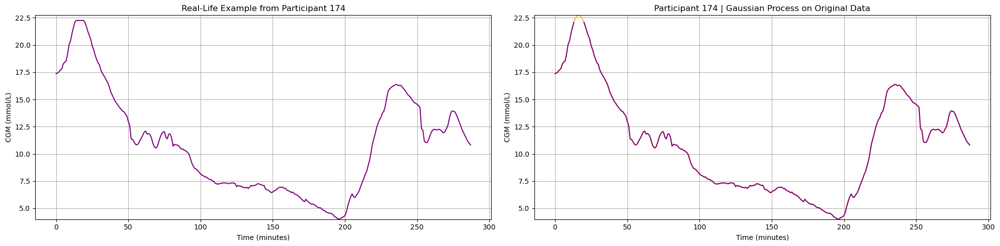

figures/paper/real_life_example/real_life_example_weinstock174.png


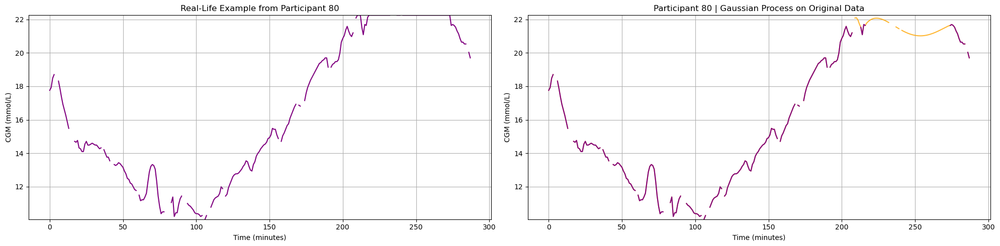

figures/paper/real_life_example/real_life_example_weinstock80.png


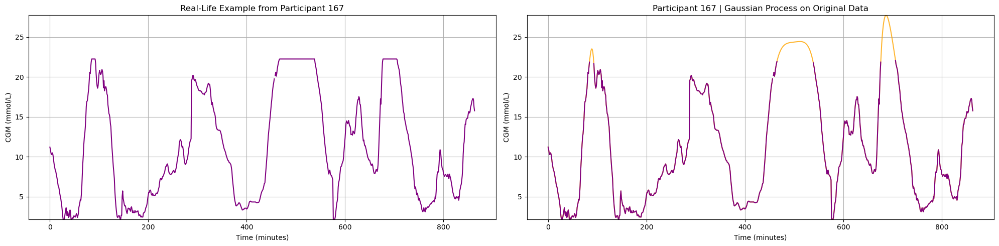

figures/paper/real_life_example/real_life_example_weinstock167.png


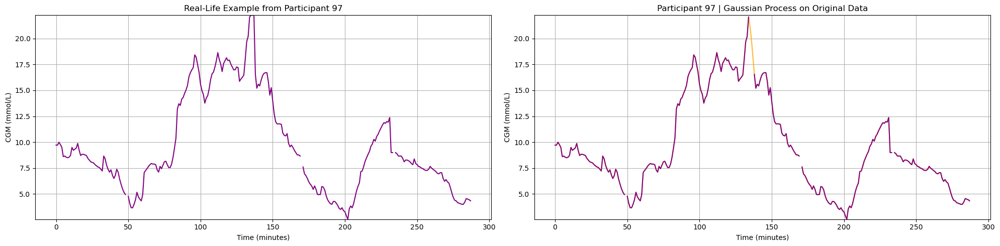

figures/paper/real_life_example/real_life_example_weinstock97.png


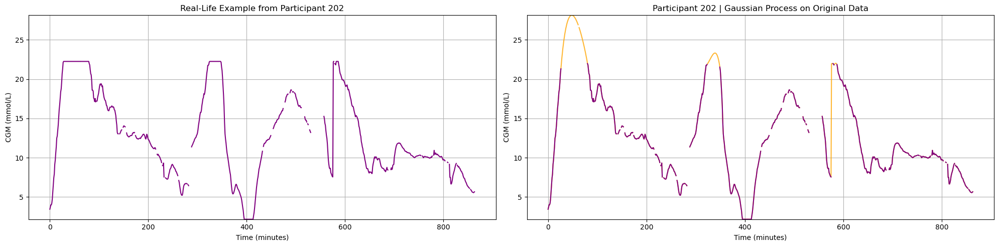

figures/paper/real_life_example/real_life_example_weinstock202.png


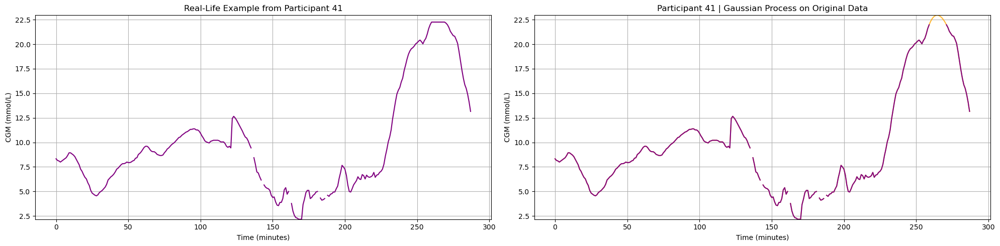

figures/paper/real_life_example/real_life_example_weinstock41.png


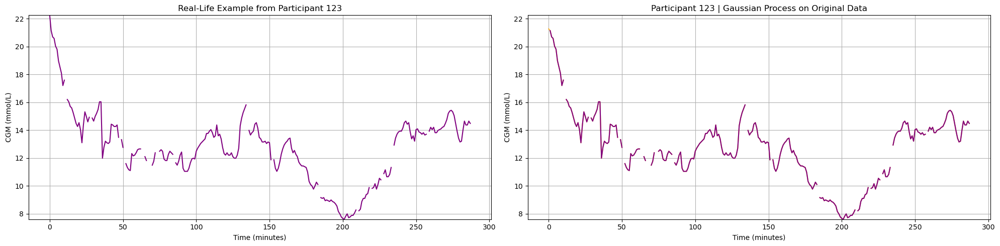

figures/paper/real_life_example/real_life_example_weinstock123.png


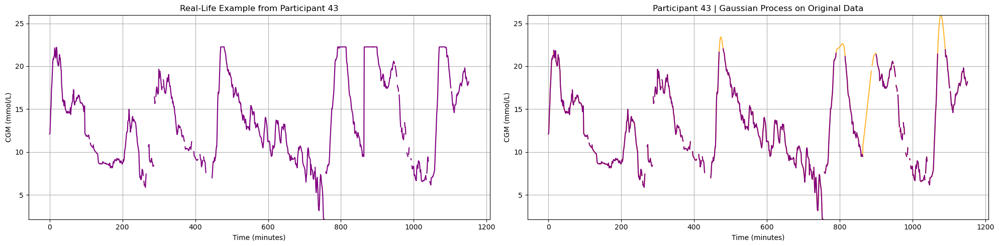

figures/paper/real_life_example/real_life_example_weinstock43.png


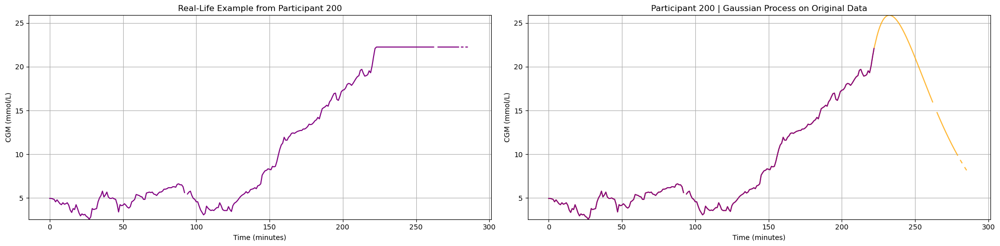

figures/paper/real_life_example/real_life_example_weinstock200.png


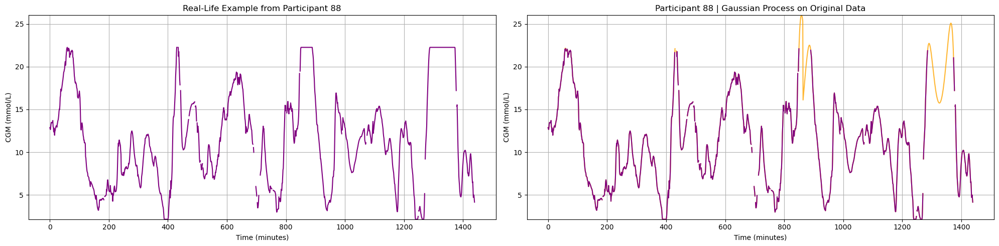

figures/paper/real_life_example/real_life_example_weinstock88.png


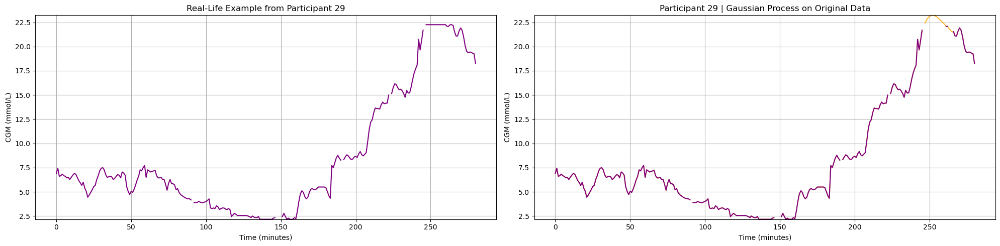

figures/paper/real_life_example/real_life_example_weinstock29.png


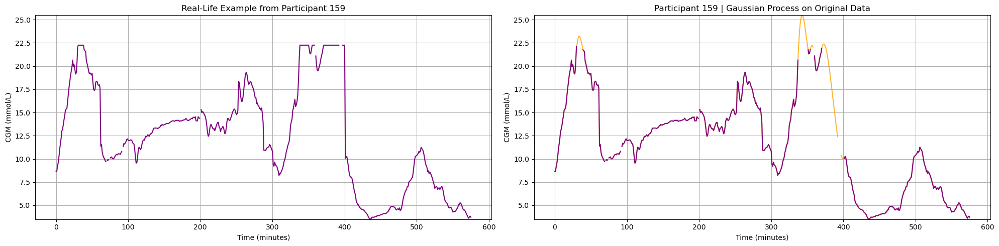

figures/paper/real_life_example/real_life_example_weinstock159.png


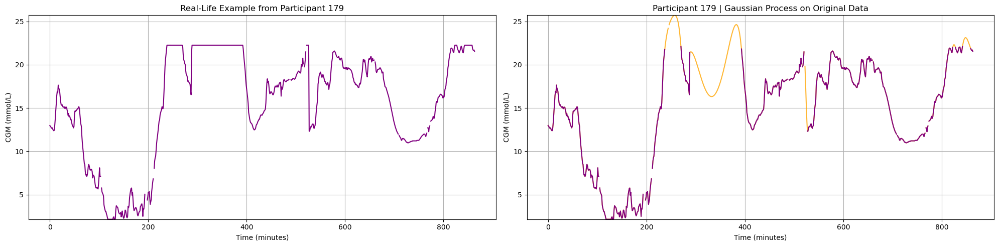

figures/paper/real_life_example/real_life_example_weinstock179.png


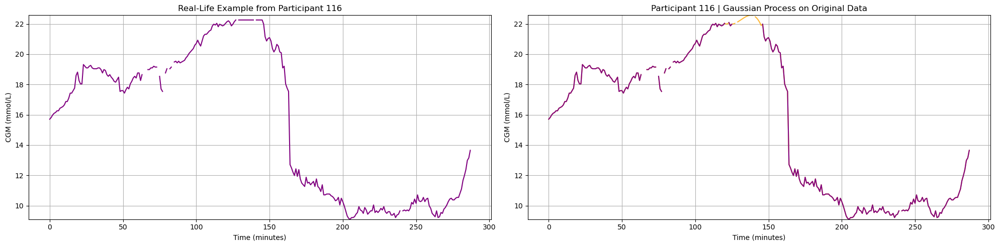

figures/paper/real_life_example/real_life_example_weinstock116.png


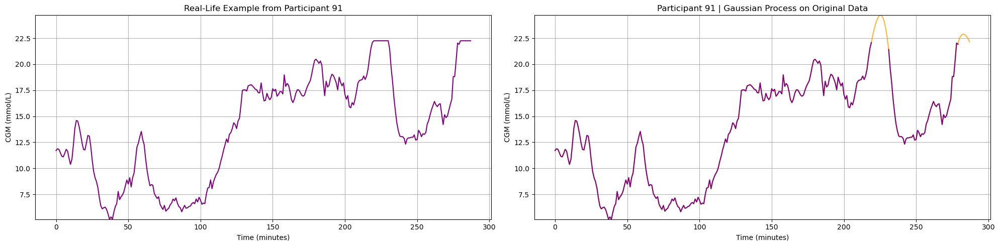

figures/paper/real_life_example/real_life_example_weinstock91.png


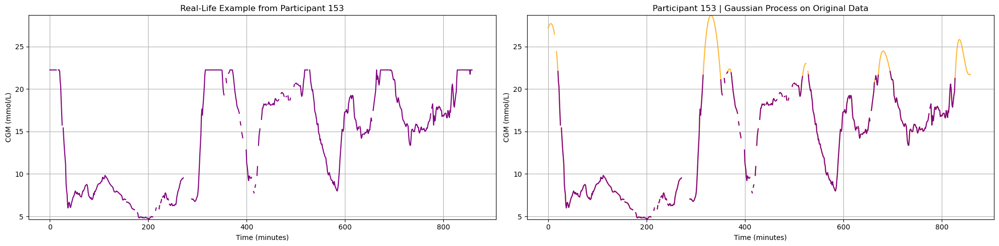

figures/paper/real_life_example/real_life_example_weinstock153.png


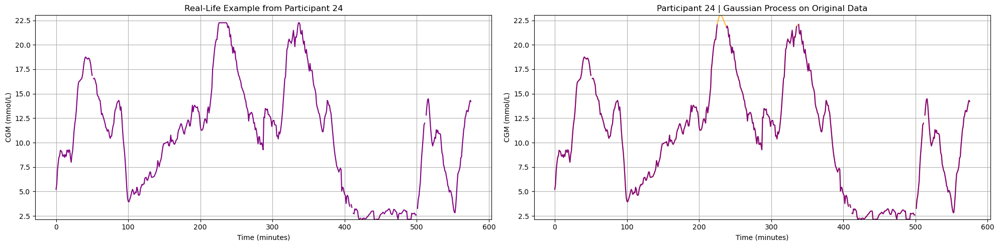

figures/paper/real_life_example/real_life_example_weinstock24.png


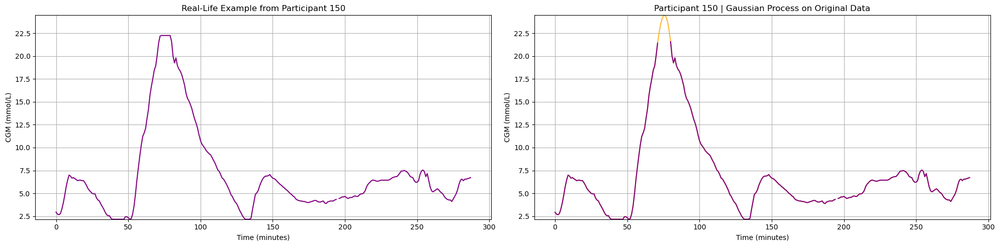

figures/paper/real_life_example/real_life_example_weinstock150.png


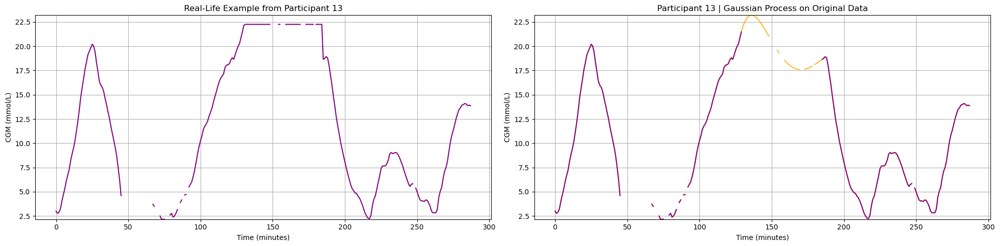

figures/paper/real_life_example/real_life_example_weinstock13.png


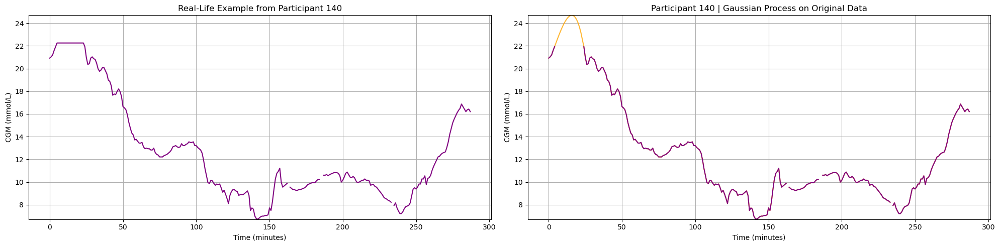

figures/paper/real_life_example/real_life_example_weinstock140.png


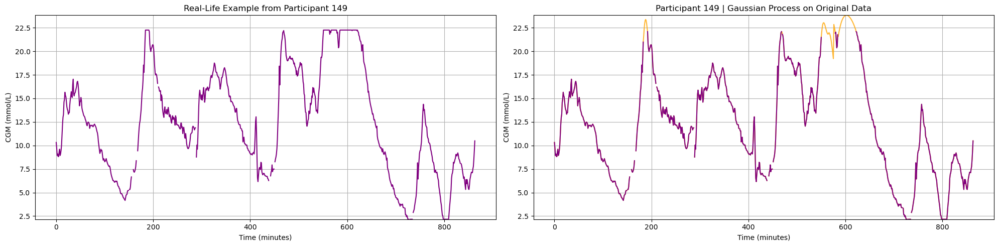

figures/paper/real_life_example/real_life_example_weinstock149.png


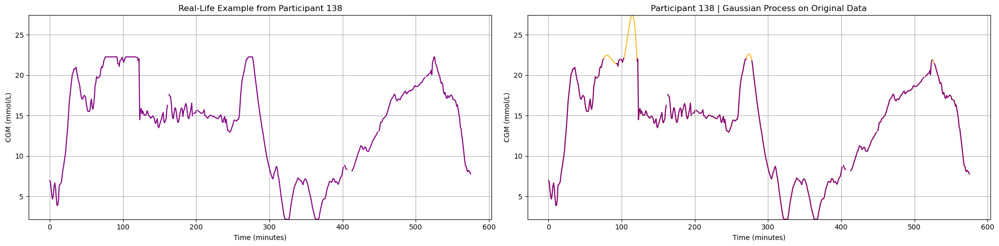

figures/paper/real_life_example/real_life_example_weinstock138.png


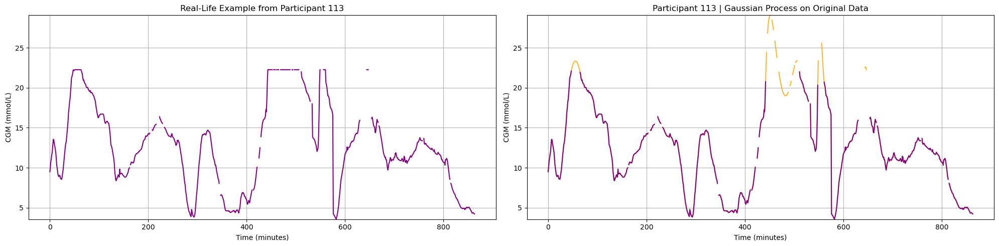

figures/paper/real_life_example/real_life_example_weinstock113.png


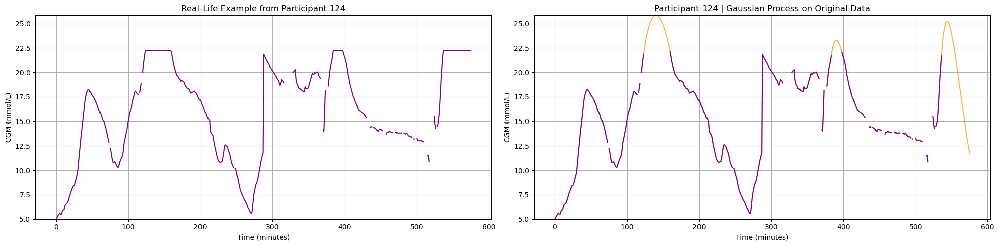

figures/paper/real_life_example/real_life_example_weinstock124.png


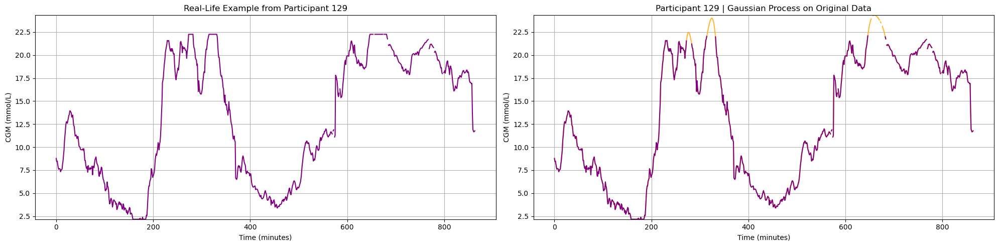

figures/paper/real_life_example/real_life_example_weinstock129.png


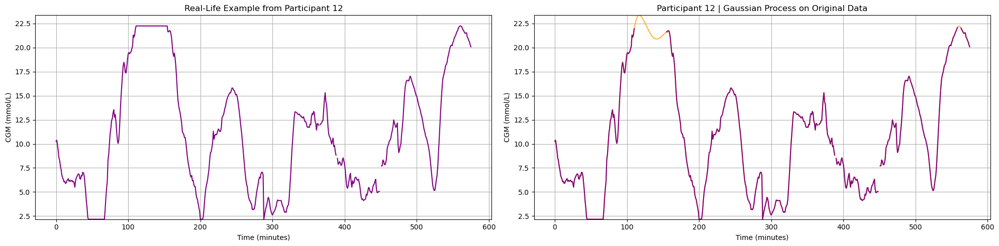

figures/paper/real_life_example/real_life_example_weinstock12.png


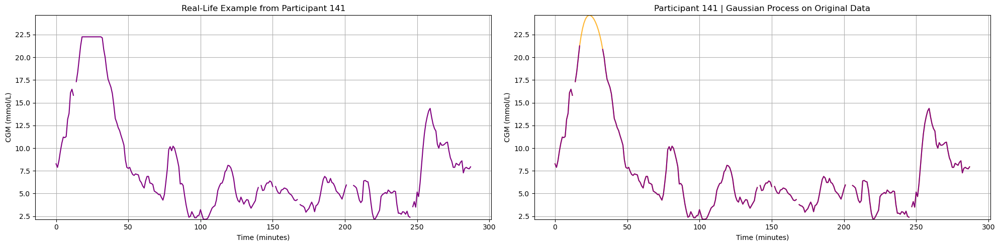

figures/paper/real_life_example/real_life_example_weinstock141.png


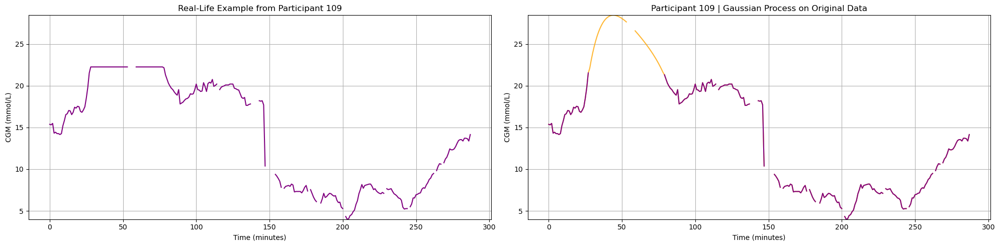

figures/paper/real_life_example/real_life_example_weinstock109.png


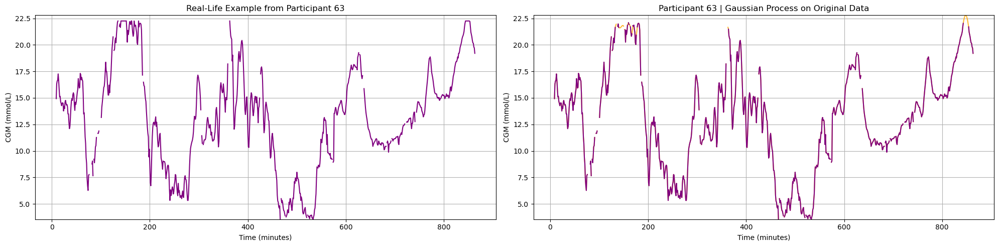

figures/paper/real_life_example/real_life_example_weinstock63.png


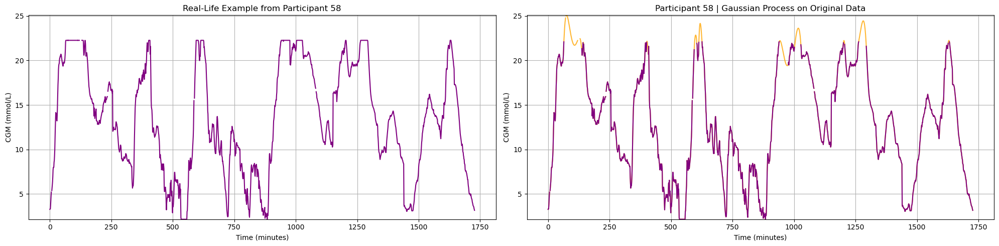

figures/paper/real_life_example/real_life_example_weinstock58.png


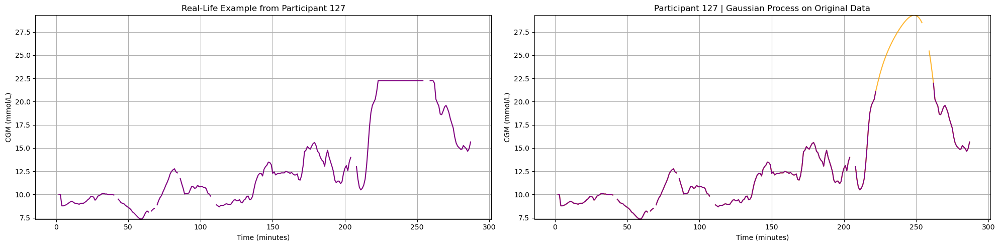

figures/paper/real_life_example/real_life_example_weinstock127.png


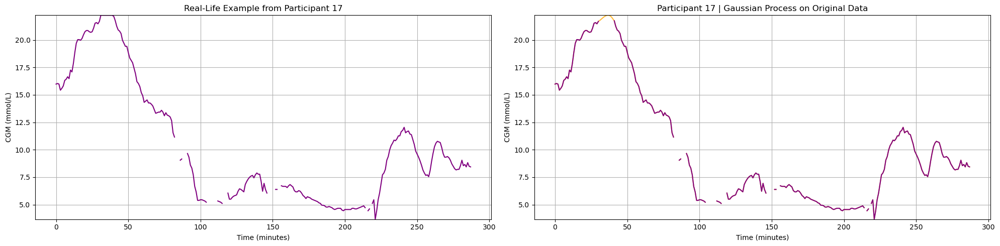

figures/paper/real_life_example/real_life_example_weinstock17.png


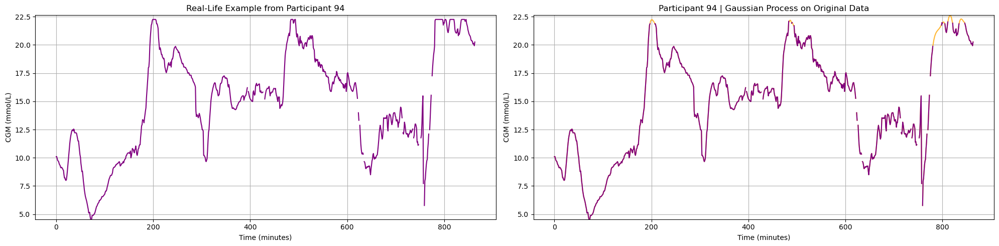

figures/paper/real_life_example/real_life_example_weinstock94.png


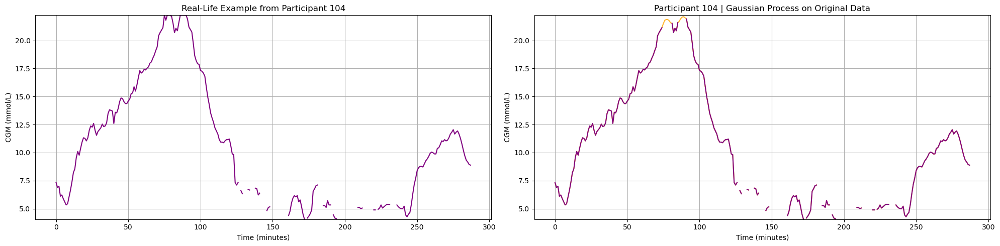

figures/paper/real_life_example/real_life_example_weinstock104.png


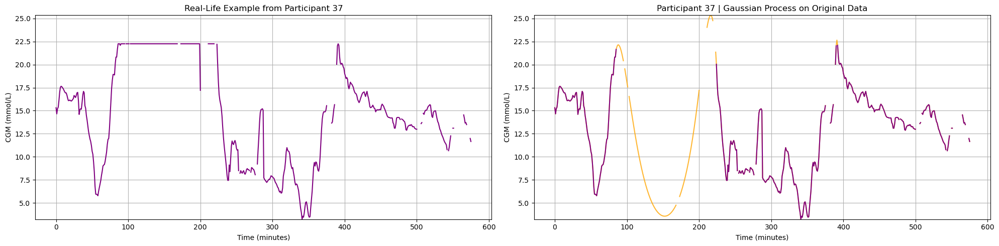

figures/paper/real_life_example/real_life_example_weinstock37.png


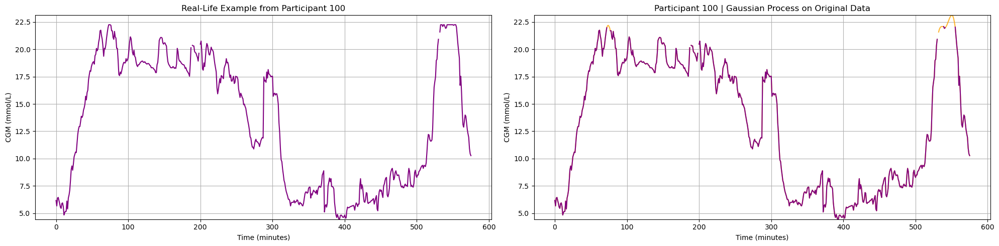

figures/paper/real_life_example/real_life_example_weinstock100.png


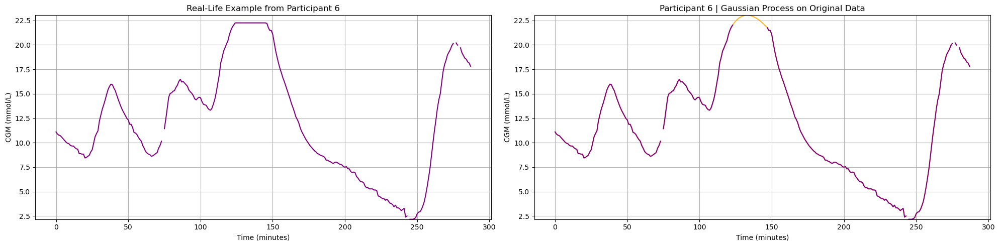

figures/paper/real_life_example/real_life_example_weinstock6.png


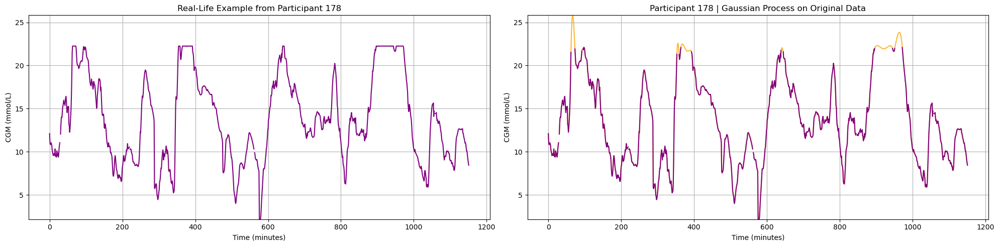

figures/paper/real_life_example/real_life_example_weinstock178.png


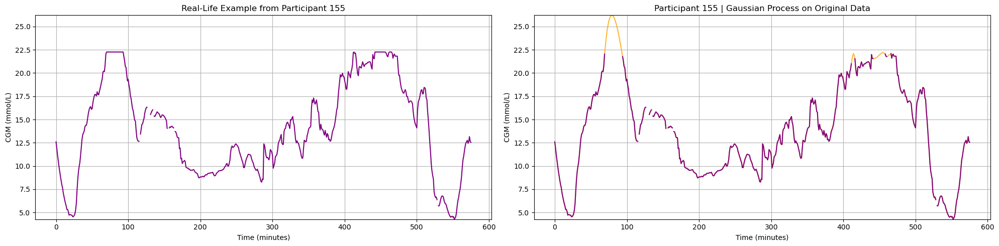

figures/paper/real_life_example/real_life_example_weinstock155.png


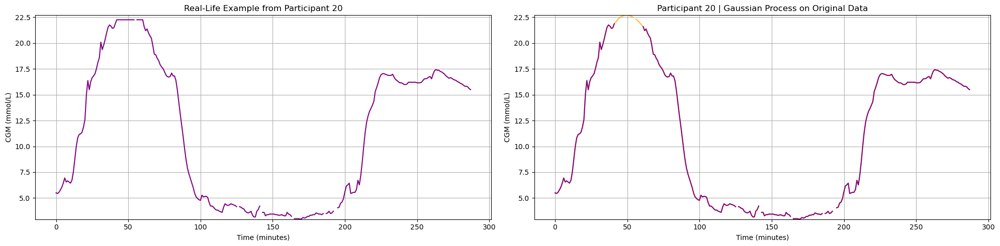

figures/paper/real_life_example/real_life_example_weinstock20.png


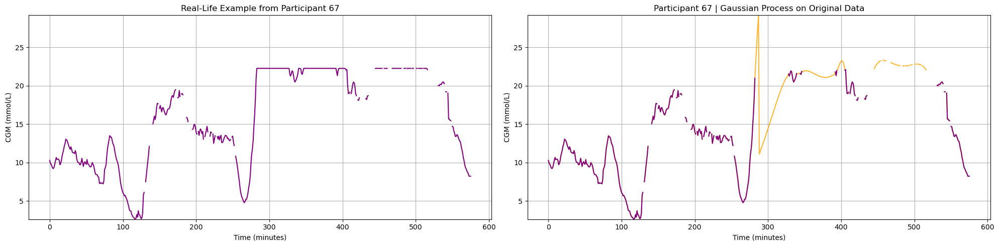

figures/paper/real_life_example/real_life_example_weinstock67.png


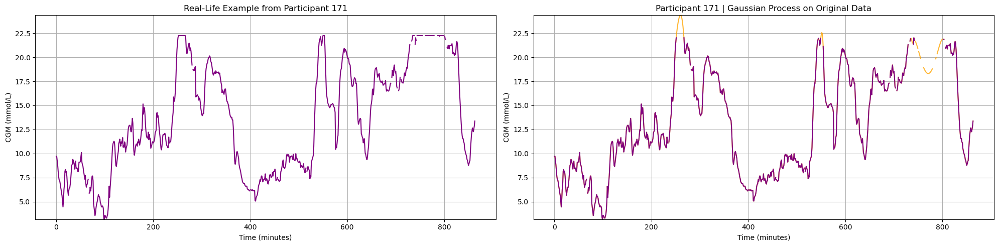

figures/paper/real_life_example/real_life_example_weinstock171.png


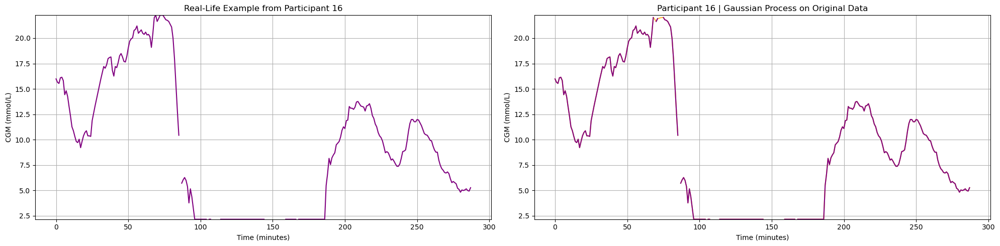

figures/paper/real_life_example/real_life_example_weinstock16.png


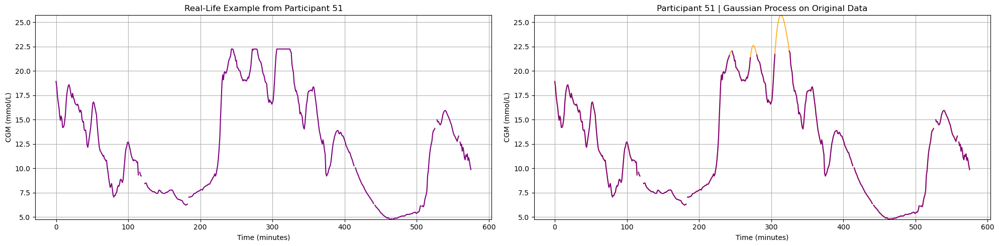

figures/paper/real_life_example/real_life_example_weinstock51.png


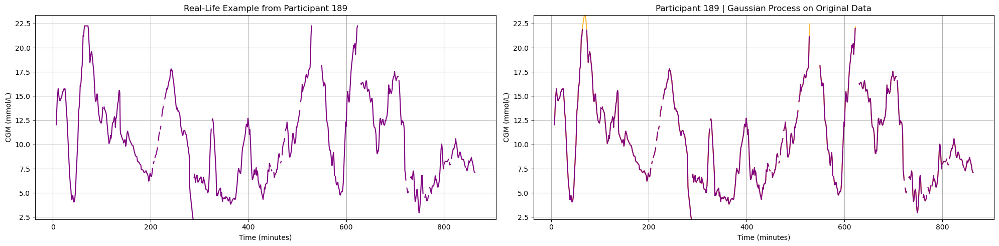

figures/paper/real_life_example/real_life_example_weinstock189.png


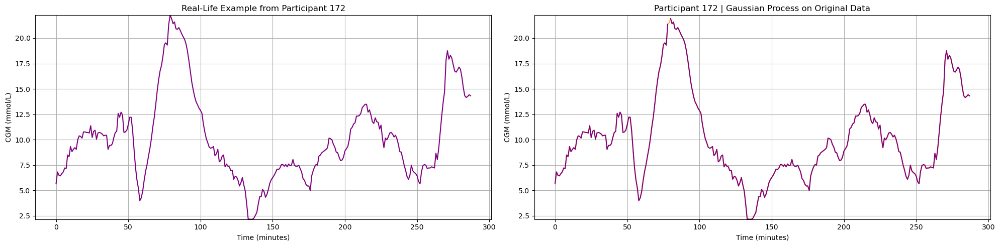

figures/paper/real_life_example/real_life_example_weinstock172.png


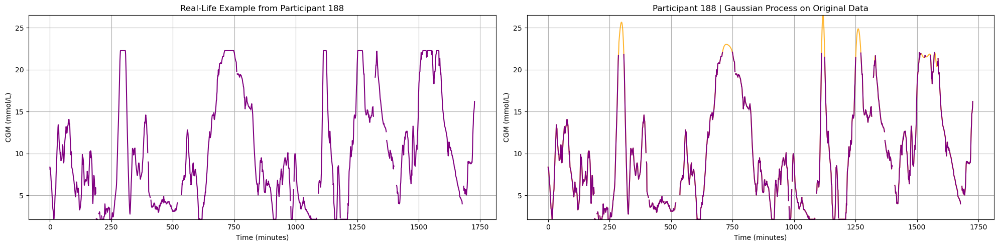

figures/paper/real_life_example/real_life_example_weinstock188.png


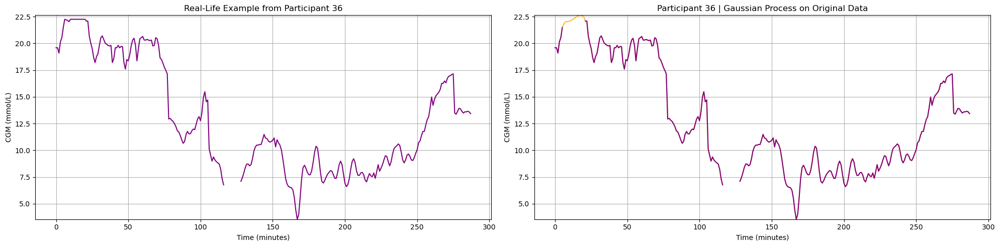

figures/paper/real_life_example/real_life_example_weinstock36.png


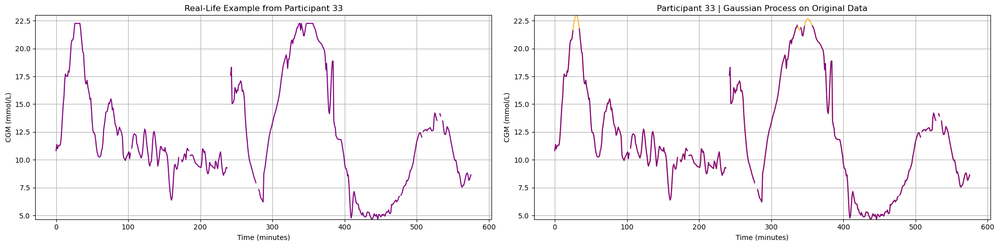

figures/paper/real_life_example/real_life_example_weinstock33.png


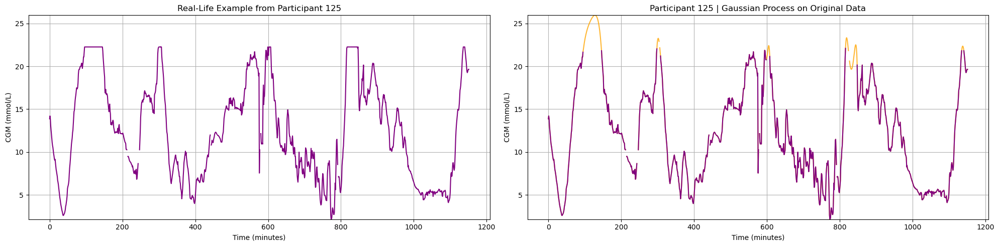

figures/paper/real_life_example/real_life_example_weinstock125.png


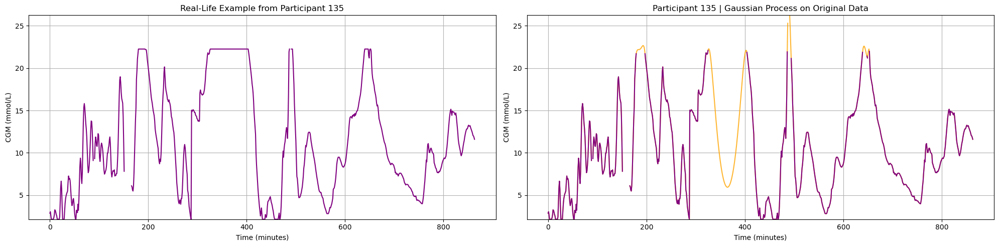

figures/paper/real_life_example/real_life_example_weinstock135.png


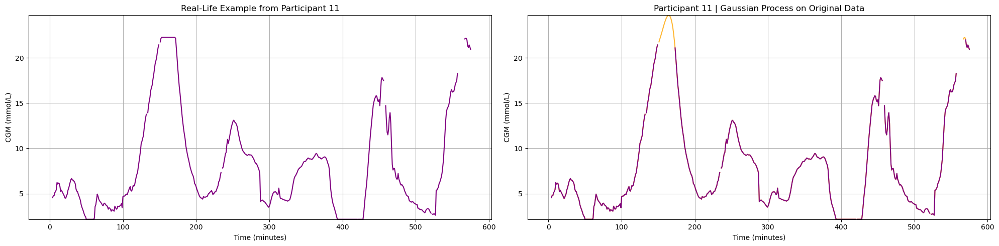

figures/paper/real_life_example/real_life_example_weinstock11.png


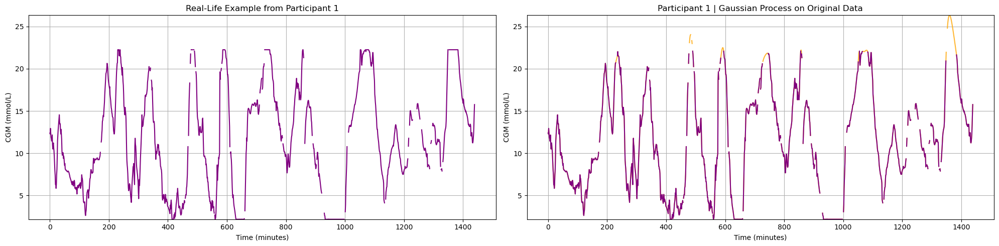

figures/paper/real_life_example/real_life_example_weinstock1.png


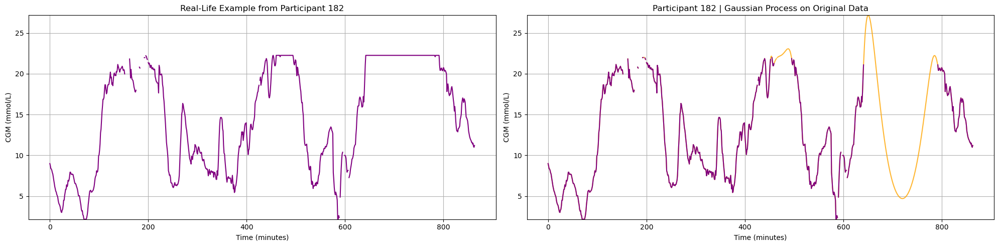

figures/paper/real_life_example/real_life_example_weinstock182.png


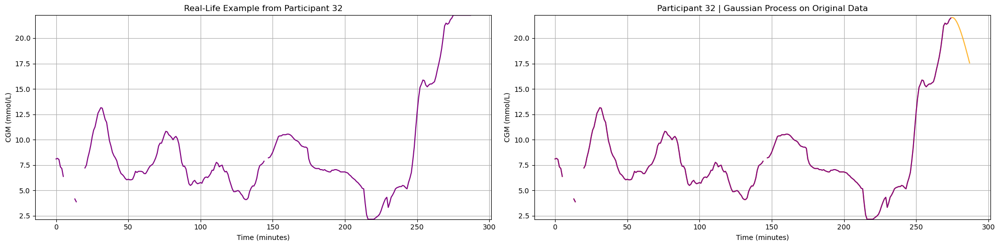

figures/paper/real_life_example/real_life_example_weinstock32.png


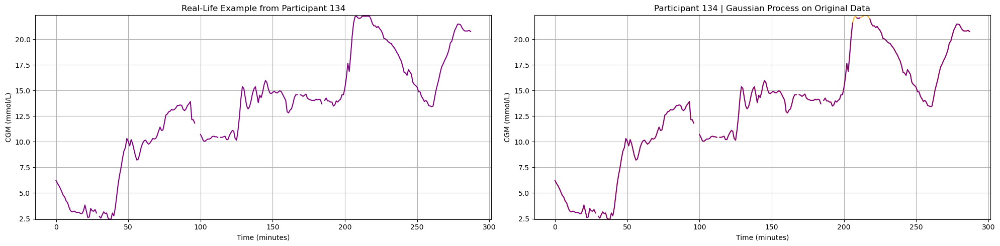

figures/paper/real_life_example/real_life_example_weinstock134.png


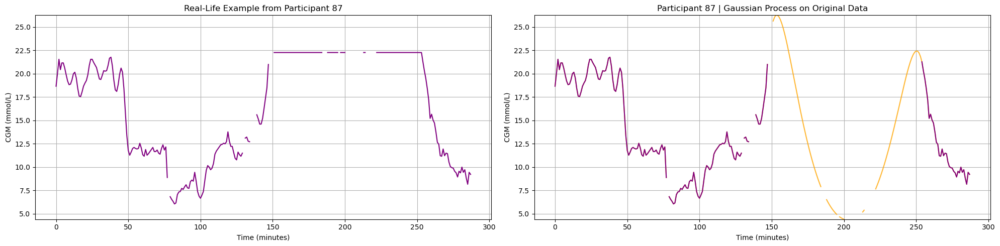

figures/paper/real_life_example/real_life_example_weinstock87.png


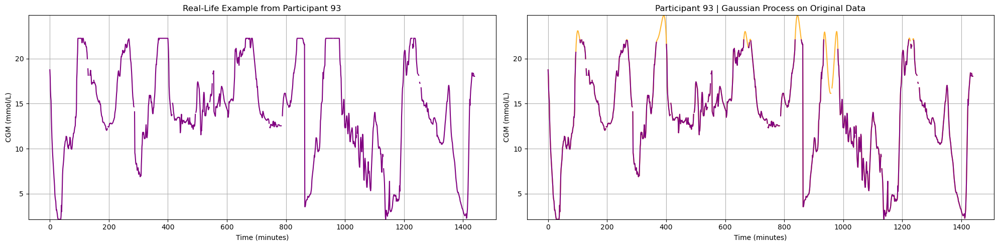

figures/paper/real_life_example/real_life_example_weinstock93.png


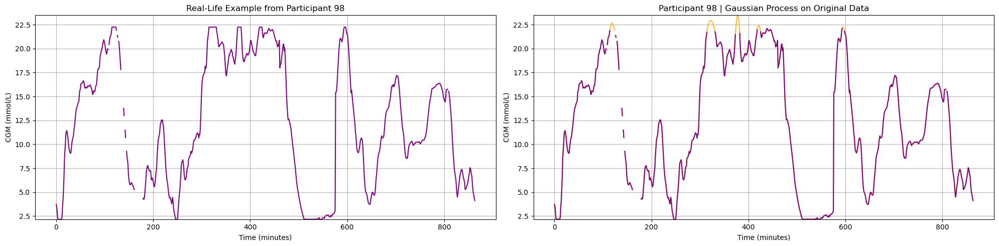

figures/paper/real_life_example/real_life_example_weinstock98.png


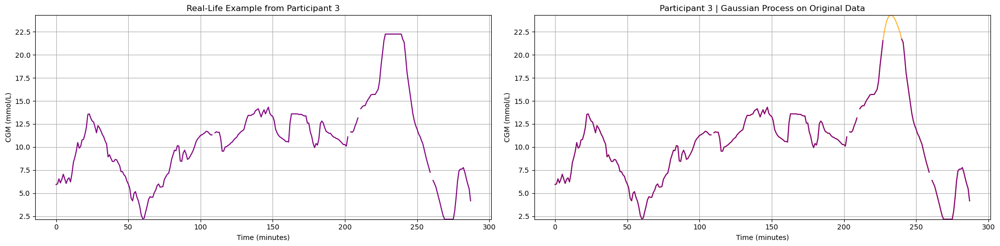

figures/paper/real_life_example/real_life_example_weinstock3.png


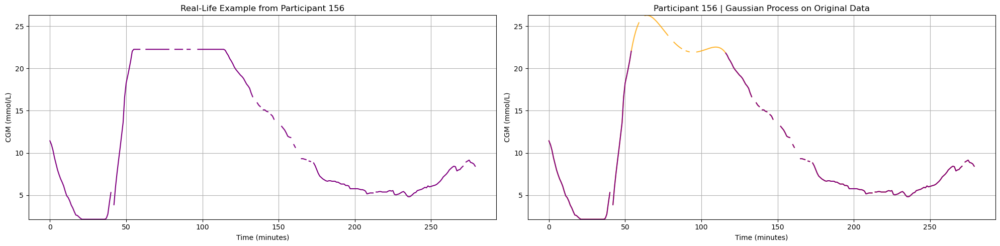

figures/paper/real_life_example/real_life_example_weinstock156.png


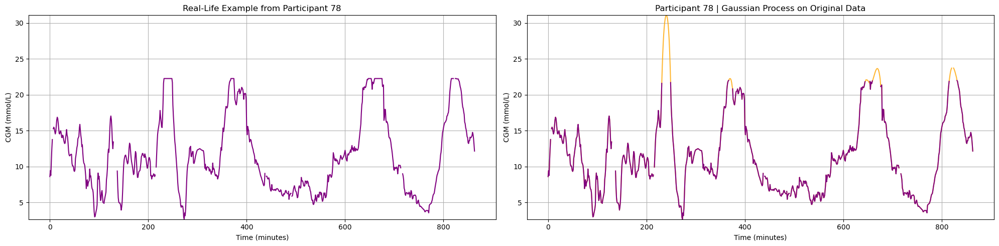

figures/paper/real_life_example/real_life_example_weinstock78.png


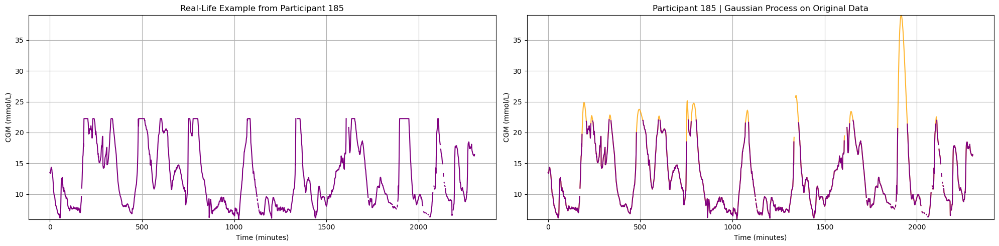

figures/paper/real_life_example/real_life_example_weinstock185.png


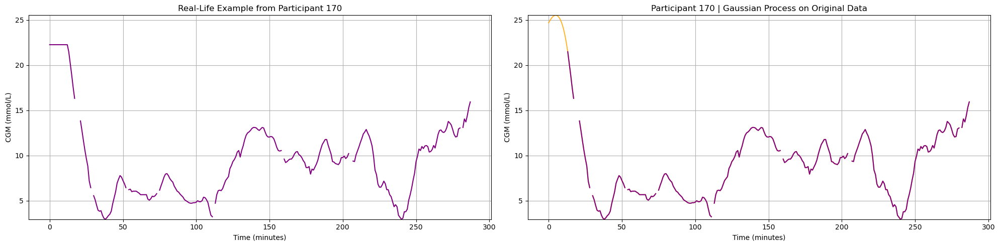

figures/paper/real_life_example/real_life_example_weinstock170.png


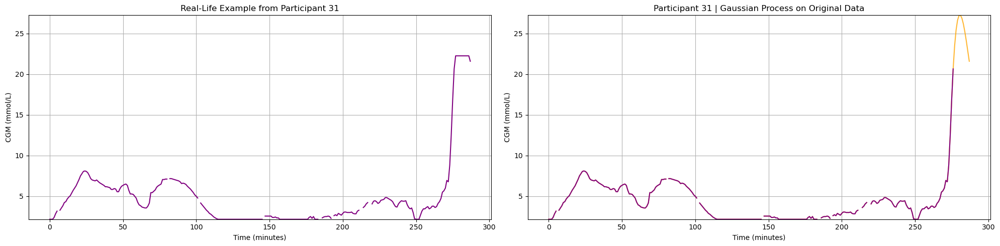

figures/paper/real_life_example/real_life_example_weinstock31.png


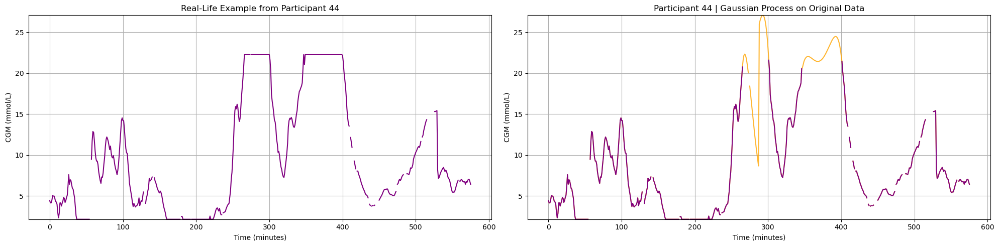

figures/paper/real_life_example/real_life_example_weinstock44.png


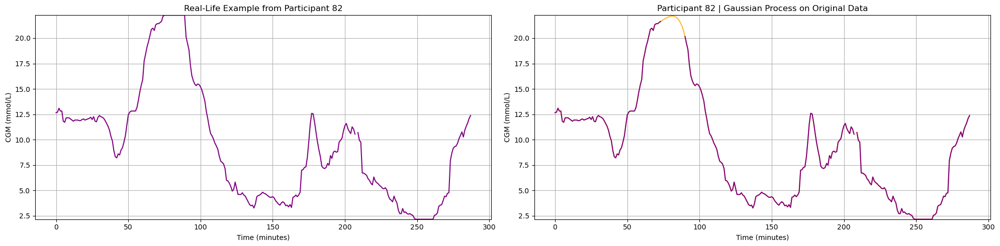

figures/paper/real_life_example/real_life_example_weinstock82.png


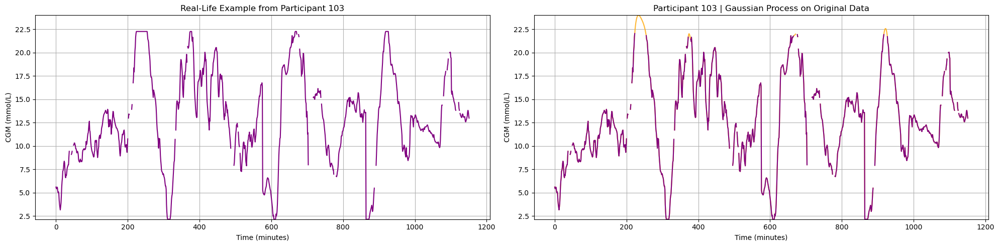

figures/paper/real_life_example/real_life_example_weinstock103.png


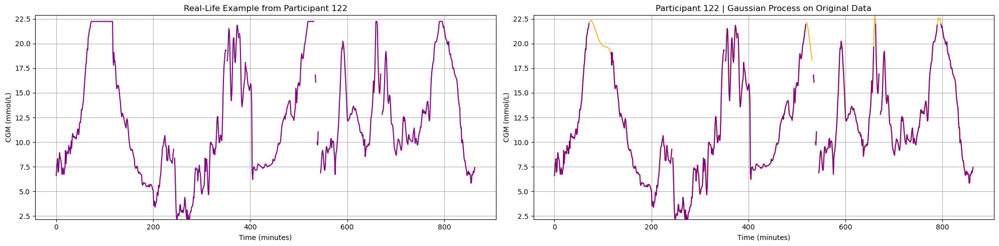

figures/paper/real_life_example/real_life_example_weinstock122.png


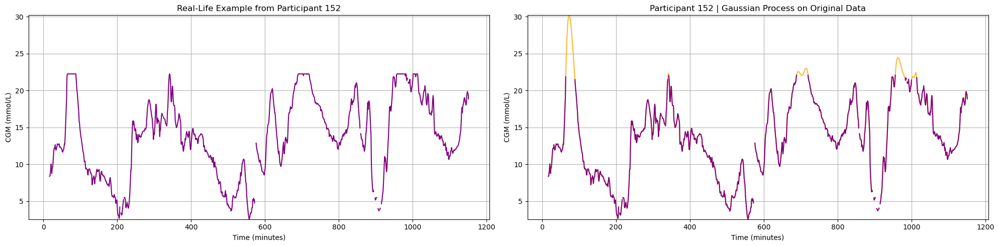

figures/paper/real_life_example/real_life_example_weinstock152.png


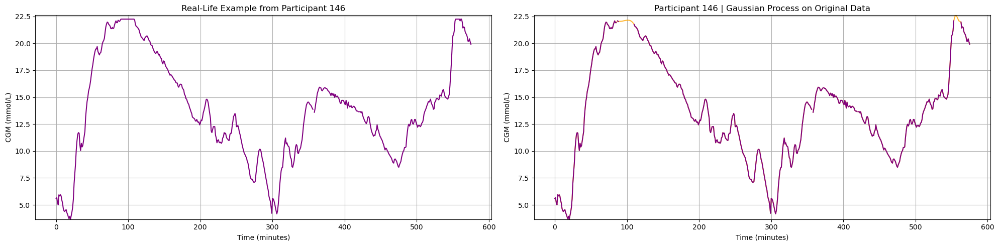

figures/paper/real_life_example/real_life_example_weinstock146.png


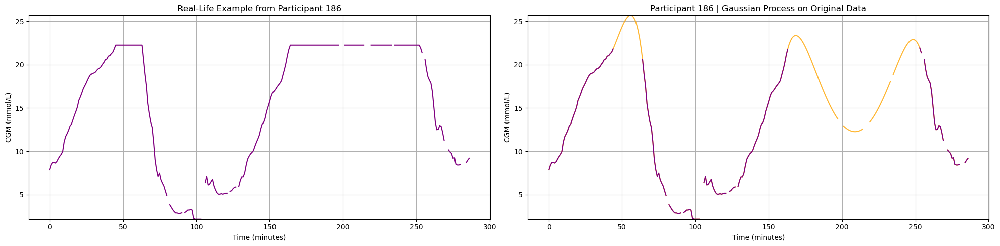

figures/paper/real_life_example/real_life_example_weinstock186.png


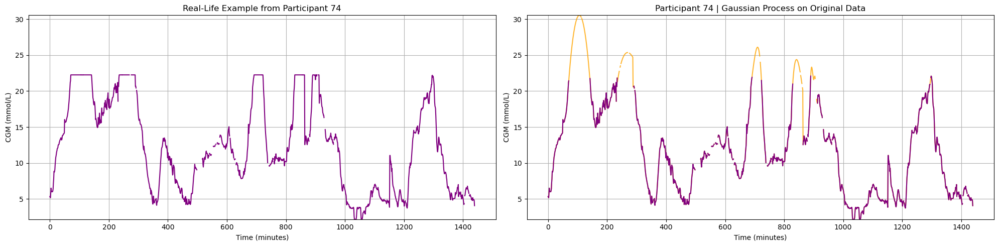

figures/paper/real_life_example/real_life_example_weinstock74.png


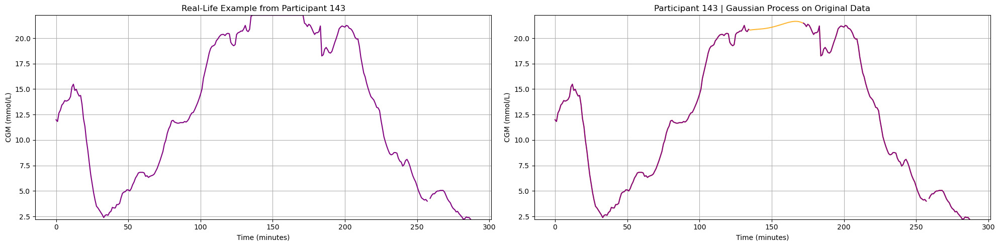

figures/paper/real_life_example/real_life_example_weinstock143.png


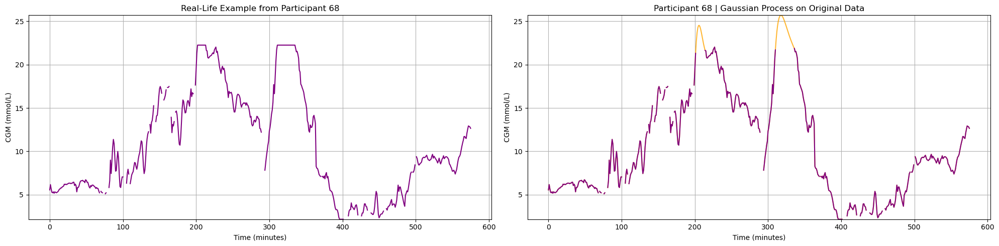

figures/paper/real_life_example/real_life_example_weinstock68.png


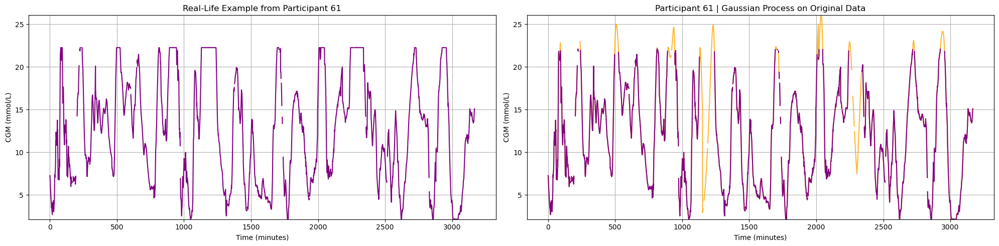

figures/paper/real_life_example/real_life_example_weinstock61.png


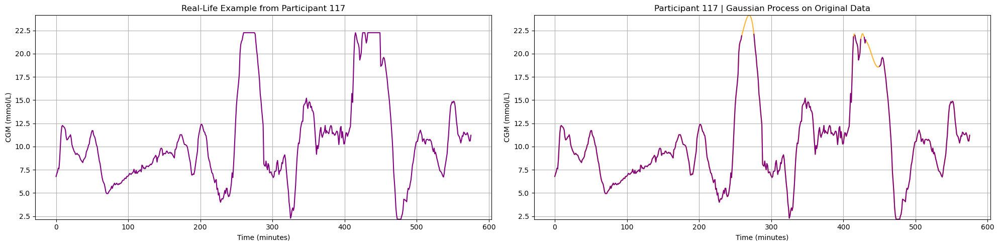

figures/paper/real_life_example/real_life_example_weinstock117.png


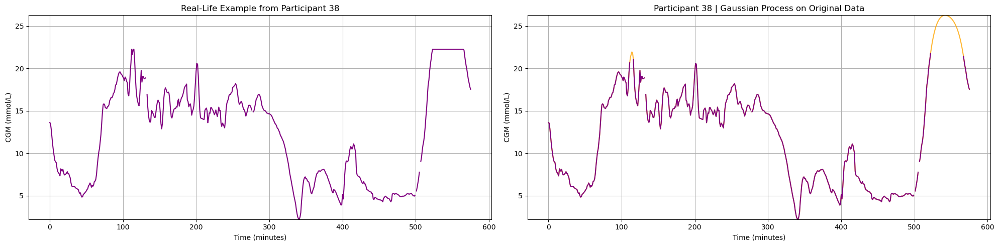

figures/paper/real_life_example/real_life_example_weinstock38.png


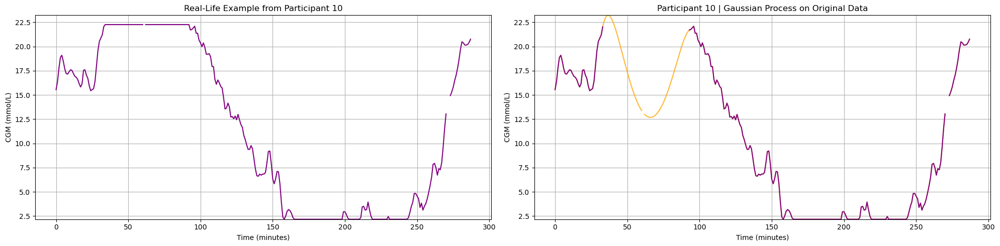

figures/paper/real_life_example/real_life_example_weinstock10.png


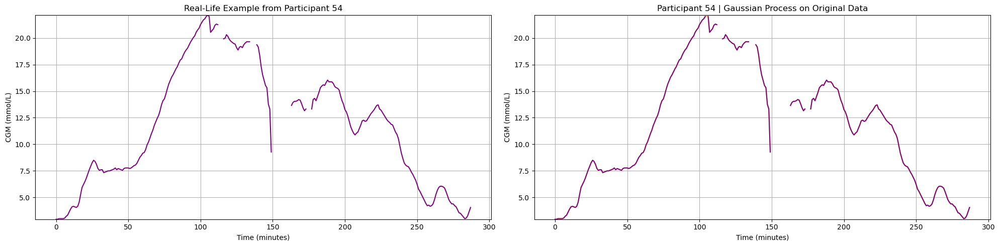

figures/paper/real_life_example/real_life_example_weinstock54.png


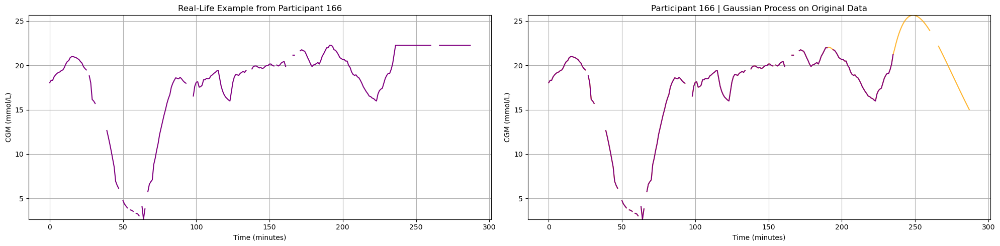

figures/paper/real_life_example/real_life_example_weinstock166.png


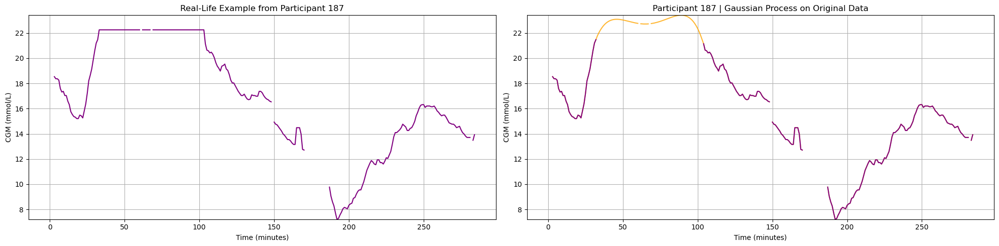

figures/paper/real_life_example/real_life_example_weinstock187.png


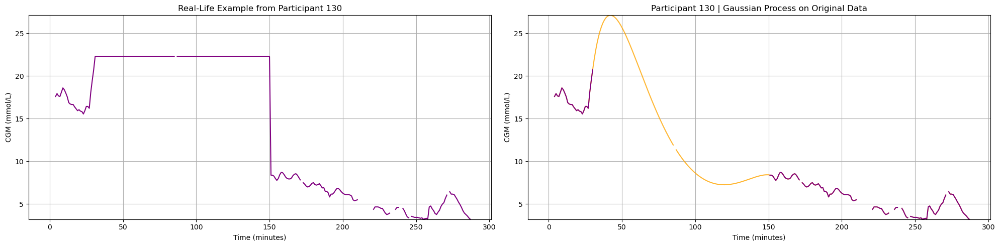

figures/paper/real_life_example/real_life_example_weinstock130.png


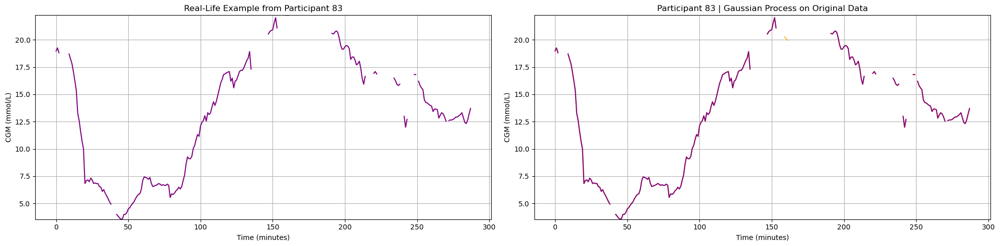

figures/paper/real_life_example/real_life_example_weinstock83.png


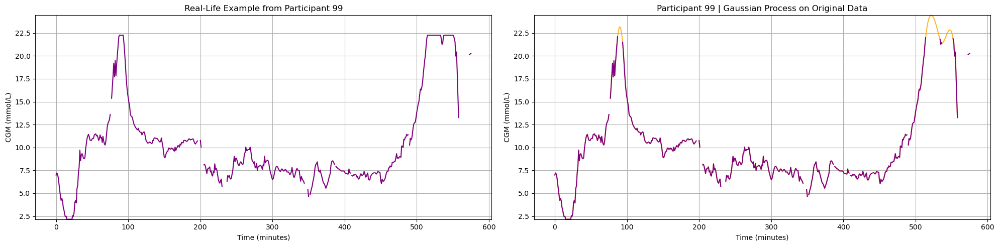

figures/paper/real_life_example/real_life_example_weinstock99.png


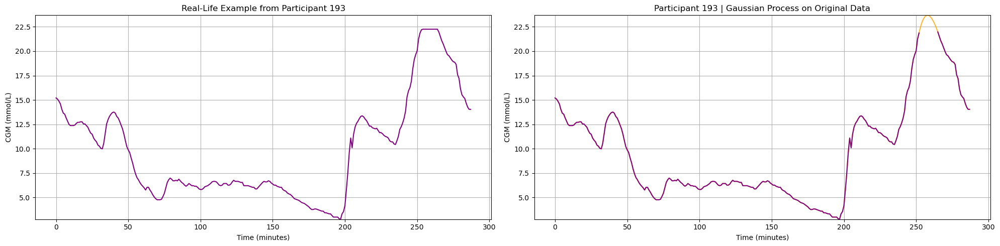

figures/paper/real_life_example/real_life_example_weinstock193.png


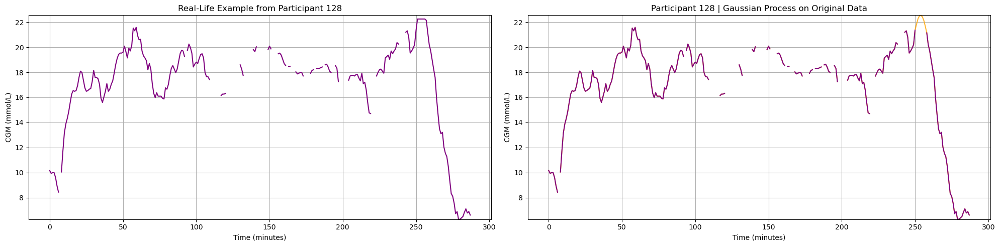

figures/paper/real_life_example/real_life_example_weinstock128.png


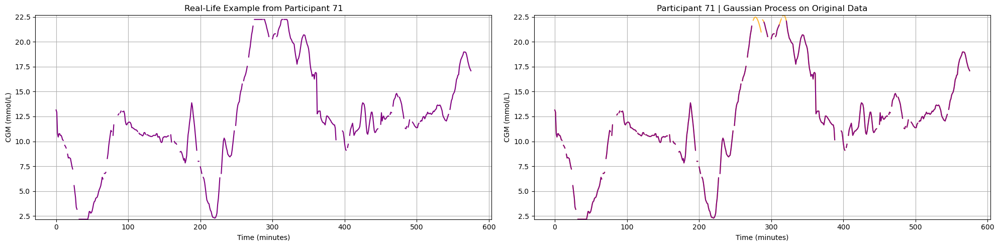

figures/paper/real_life_example/real_life_example_weinstock71.png


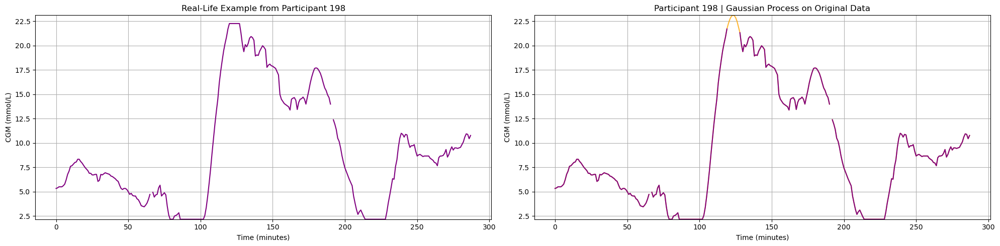

figures/paper/real_life_example/real_life_example_weinstock198.png


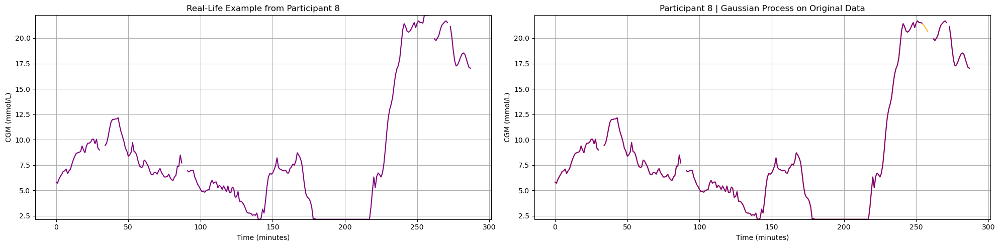

figures/paper/real_life_example/real_life_example_weinstock8.png


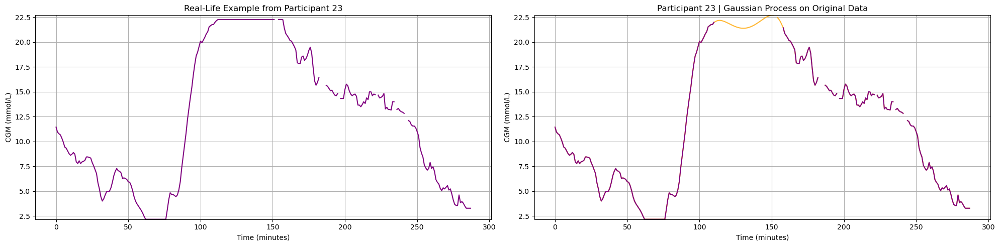

figures/paper/real_life_example/real_life_example_weinstock23.png


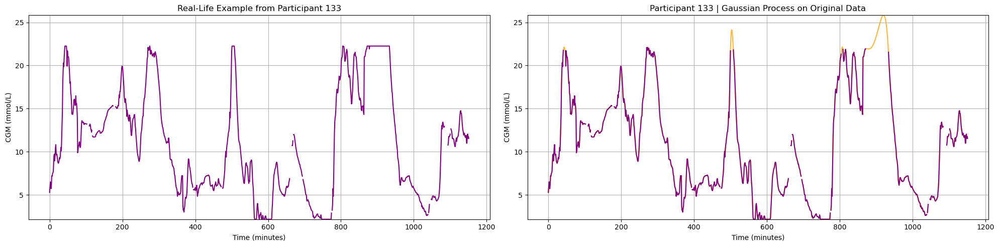

figures/paper/real_life_example/real_life_example_weinstock133.png


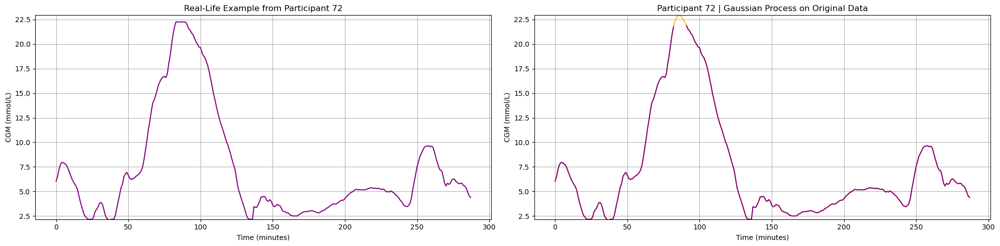

figures/paper/real_life_example/real_life_example_weinstock72.png


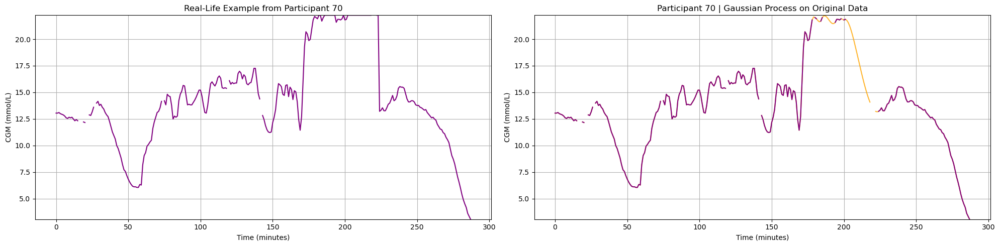

figures/paper/real_life_example/real_life_example_weinstock70.png


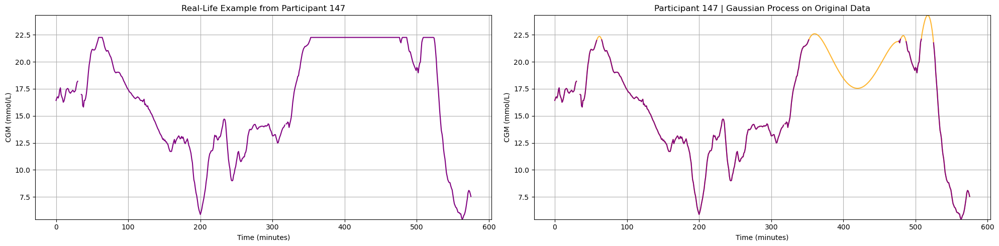

figures/paper/real_life_example/real_life_example_weinstock147.png


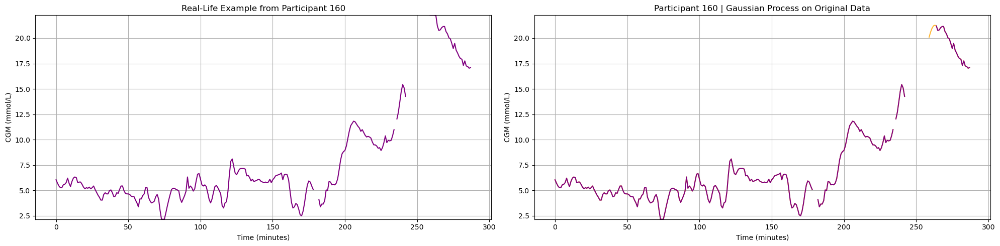

figures/paper/real_life_example/real_life_example_weinstock160.png


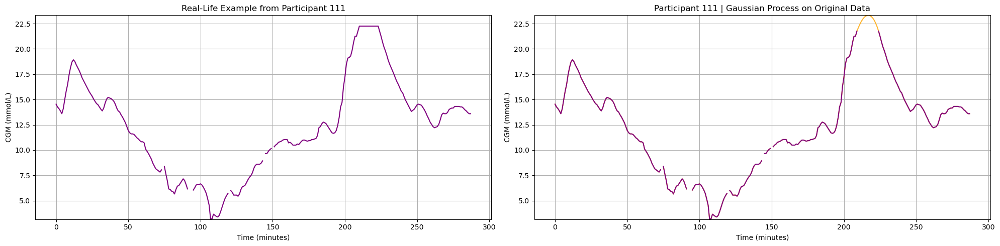

figures/paper/real_life_example/real_life_example_weinstock111.png


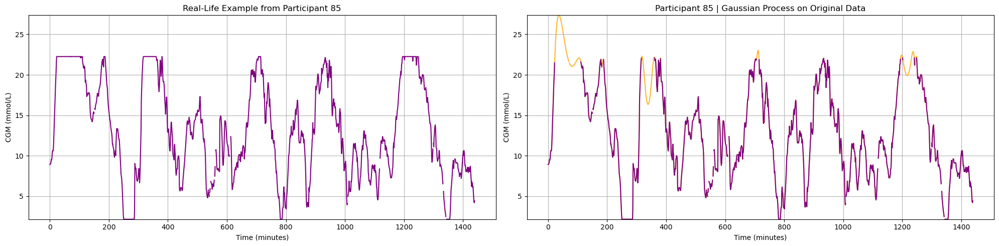

figures/paper/real_life_example/real_life_example_weinstock85.png


In [21]:
main(dataset='weinstock')

Loading data...
dict_keys(['121', '153', '155', '157', '161', '172', '185', '191', '195', '22', '23', '25', '28', '31', '56', '86', '93'])
dict_keys(['Subject 1', 'Subject 2', 'Subject 3', 'Subject 4', 'Subject 5'])
dict_keys(['1636-69-001', '1636-69-091', '2133-004', '2133-018', '2133-039'])


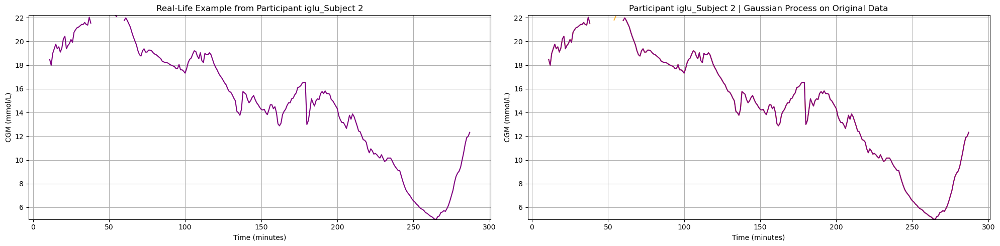

In [23]:
main(dataset='t2d')

Loading data...


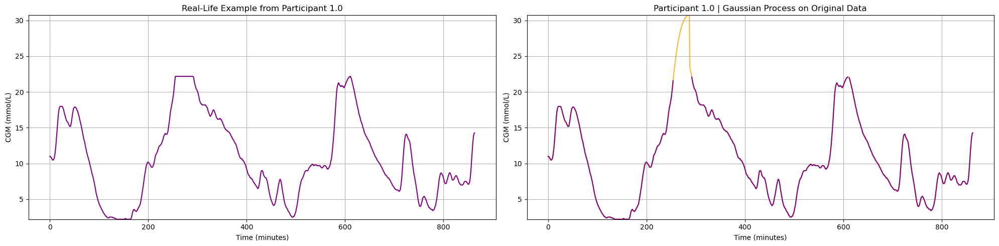

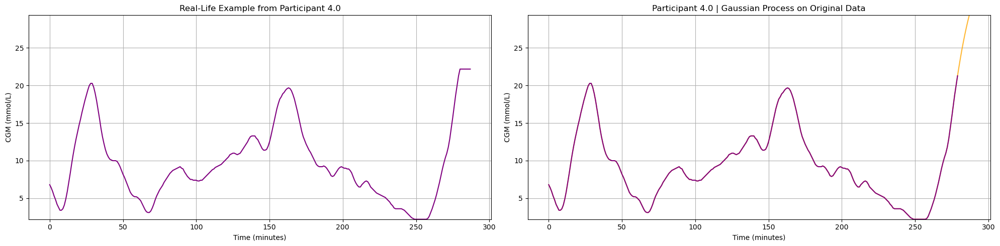

In [24]:
main(dataset='dubosson')

In [25]:
main(dataset='hall')

Loading data...


Loading data...


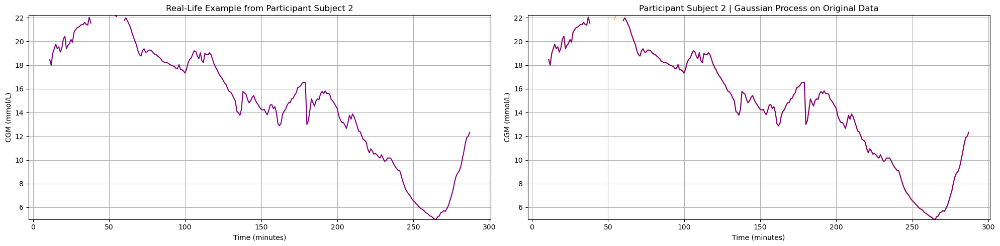

In [26]:
main(dataset='iglu')

Loading data...


 C:\Users\Maria Panagiotou\AppData\Roaming\Python\Python311\site-packages\GPy\kern\src\stationary.py:168: RuntimeWarning:overflow encountered in divide
 C:\Users\Maria Panagiotou\AppData\Roaming\Python\Python311\site-packages\GPy\kern\src\stationary.py:489: RuntimeWarning:overflow encountered in multiply
 C:\Users\Maria Panagiotou\AppData\Roaming\Python\Python311\site-packages\GPy\kern\src\stationary.py:489: RuntimeWarning:invalid value encountered in multiply


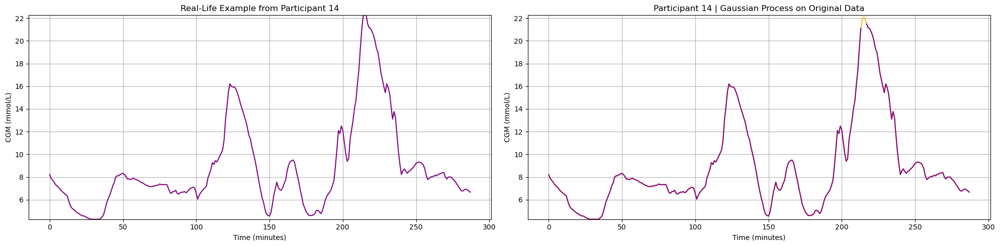

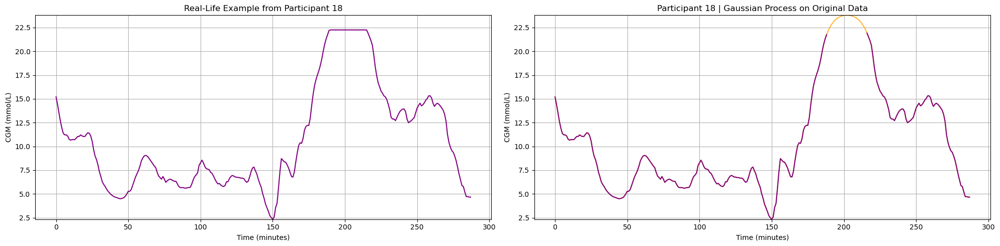

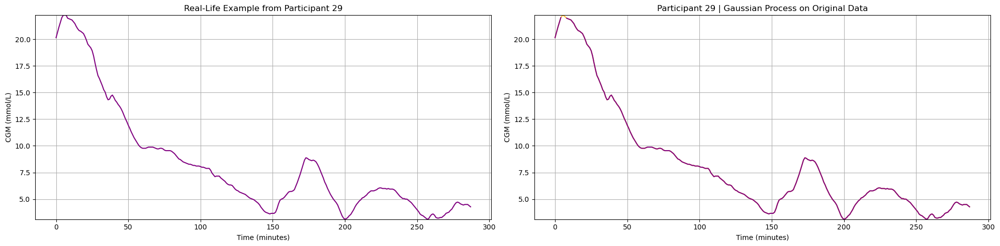

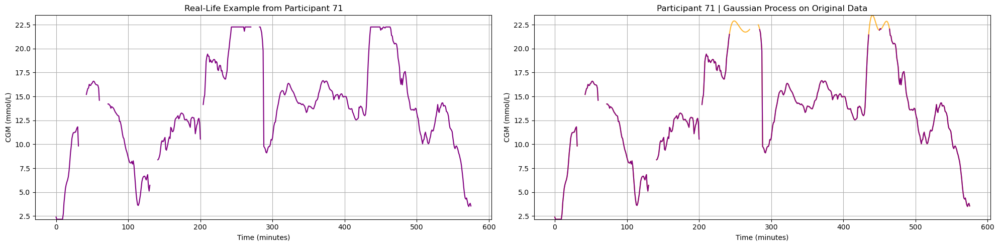

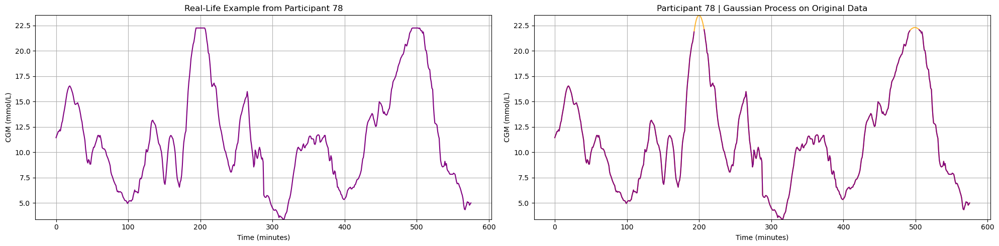

...

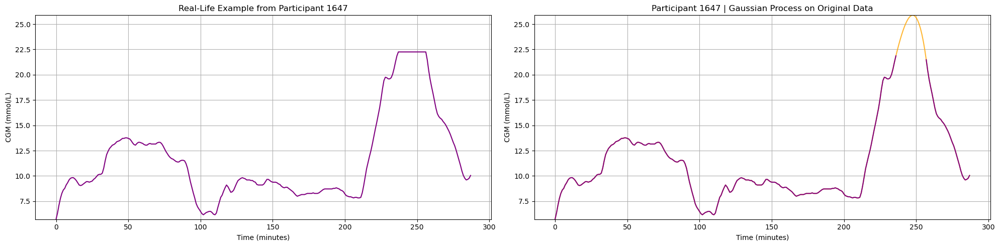

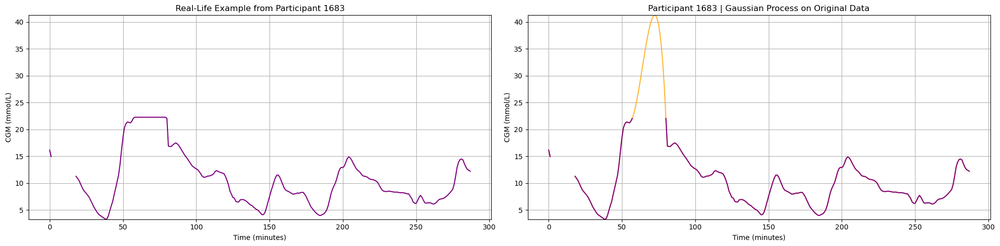

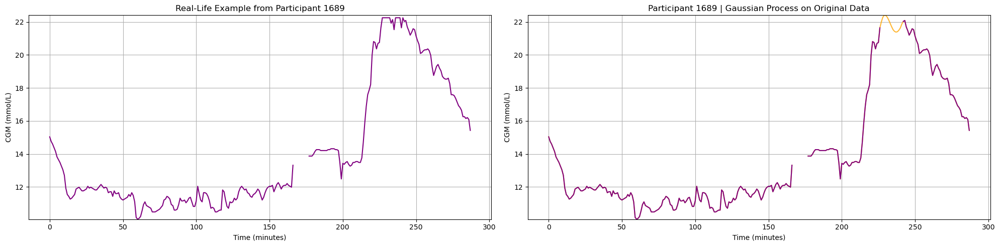

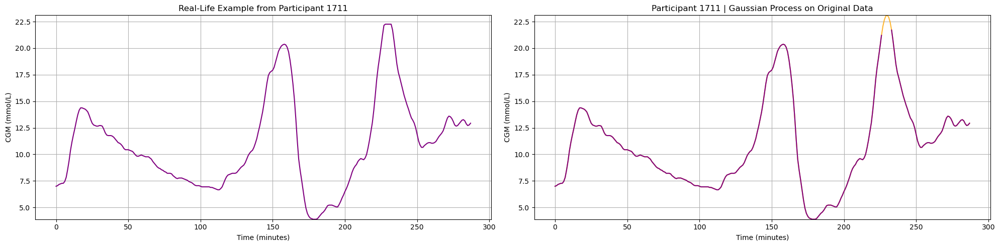

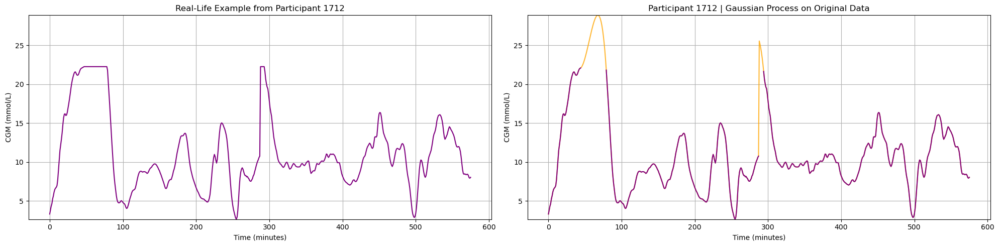

In [27]:
main(dataset='T1DEXI_adults')